# Hot Potato Inc. 
## Goals with the Crypto API:CCXT and a Libre: AML-S905X-CC Le'Potato Cluster!
- 1 Prophet Time Series analysis
- 2 Fold Change analyses 
- 3 Multi-Crypto Exchange Variation Analyses 
- Pre-full stack product prototyping in general
- Demonstrate a DIY Cluster Running Dask scheduler on a 12x Single Board Computer cluster
- Proof Of Concept QC with interactive notebooks
- Reports that can be served easily and used in situ as well
- see https://github.com/ccxt/ccxt/wiki for the API
- see https://facebook.github.io/prophet/docs/quick_start.html for the Time series package
- see https://libre.computer/products/aml-s905x-cc/ for the Hardware
- see https://docs.dask.org/en/stable/ for the Scheduler
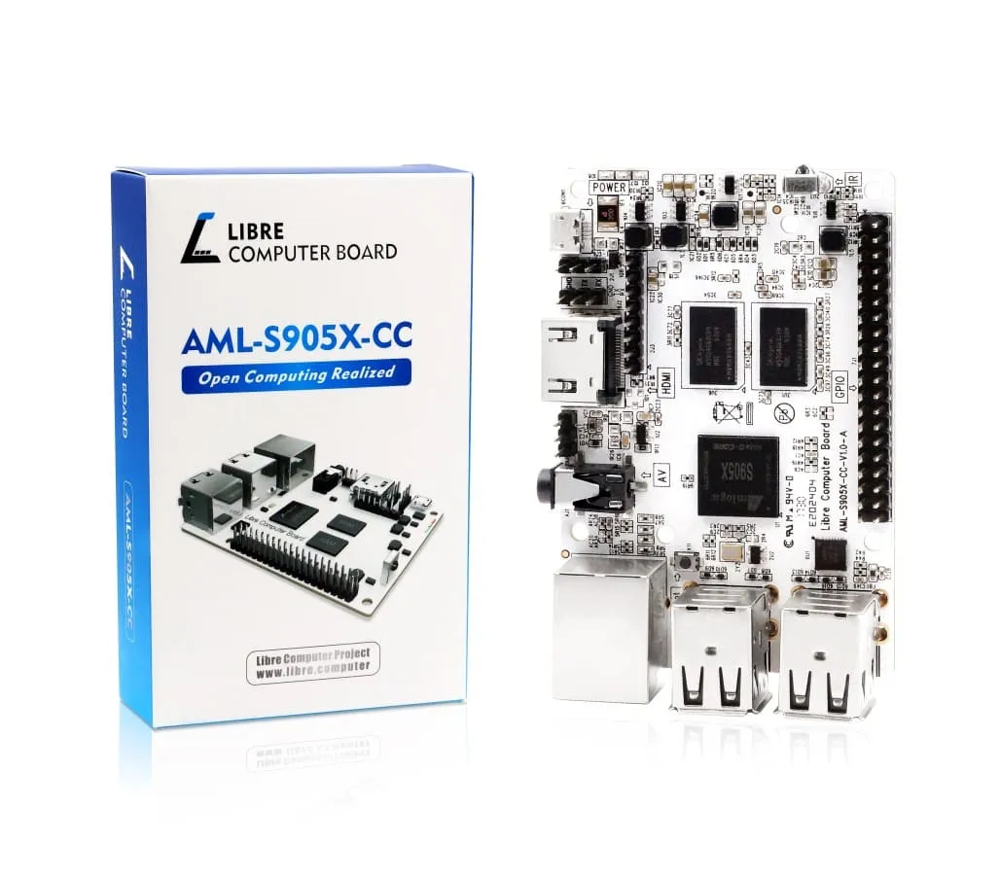

# 1. Ensure the Environment and Setup
- using the same requirements.txt as in a virtualenv
- access the Network Attached Storage

## Any runtime Installs? 
### use !pip
- e.g. prophet time series package

In [1]:
# list the environment modules
# !pip freeze

## import modules

In [5]:
import yaml

import time
import logging
import string
import json
import hashlib
import calendar
from datetime import datetime, date, timedelta
# mcgold's extras

#https://pandas.pydata.org/docs/
import pandas as pd
import numpy as np
from datetime import datetime
import sys
import re
import os
import seaborn as sns
import math
import scipy.stats as stats
import sklearn
from sklearn.metrics.pairwise import pairwise_distances
import time

#APIs
import ccxt
import prophet
from prophet import *

# cluster
import dask
from dask.distributed import Client,SSHCluster
#import dask.dataframe as dd

# graphics
import seaborn as sns
import squarify 
import matplotlib.pyplot as plt
import matplotlib 

# functional programming
import functools
from functools import reduce

#pd.set_option('display.height', 1300)
pd.set_option('display.max_rows', 20000)
pd.set_option('display.max_columns', 1000)
pd.set_option('max_colwidth',1000)
%matplotlib inline
#%autosave 0

## a generic config file

In [6]:
# Read data from the YAML file
with open('/mnt/cluster/setup/cluster_config.yaml', 'r') as file:
    config_data = yaml.safe_load(file)
#config_data

## Option 1: Stand up the SBC cluster in this notebook
- skipped here

## Option 2: Attach notebook to an already running SBC cluster 
- in play

In [7]:
try:
    notebook_client.close()
except:
    pass
notebook_client=None
notebook_client=Client('192.168.12.195:55555')

/home/ubuntu/.local/lib/python3.10/site-packages/distributed/client.py:1391: VersionMismatchWarning: Mismatched versions found

+---------+----------------+-----------------+-----------------+
| Package | Client         | Scheduler       | Workers         |
+---------+----------------+-----------------+-----------------+
| python  | 3.10.6.final.0 | 3.10.12.final.0 | 3.10.12.final.0 |
+---------+----------------+-----------------+-----------------+
  warnings.warn(version_module.VersionMismatchWarning(msg[0]["warning"]))


## Setup the CCXT api
- a generic API to market data and JSON RPC
- A crypto exchanges dictionary for convenience

In [8]:
exchange_dict={}
#exchange_dict['aax'] = ccxt.aax({'enableRateLimit': True})
exchange_dict['ascendex'] = ccxt.ascendex({'enableRateLimit': True})
exchange_dict['bequant'] = ccxt.bequant({'enableRateLimit': True})
#exchange_dict['bibox'] = ccxt.bibox({'enableRateLimit': True})
exchange_dict['bigone'] = ccxt.bigone({'enableRateLimit': True})
exchange_dict['binance'] = ccxt.binance({'enableRateLimit': True})
exchange_dict['binancecoinm'] = ccxt.binancecoinm({'enableRateLimit': True})
exchange_dict['binanceus'] = ccxt.binanceus({'enableRateLimit': True})
exchange_dict['binanceusdm'] = ccxt.binanceusdm({'enableRateLimit': True})
exchange_dict['bit2c'] = ccxt.bit2c({'enableRateLimit': True})
exchange_dict['bitbank'] = ccxt.bitbank({'enableRateLimit': True})
exchange_dict['bitbay'] = ccxt.bitbay({'enableRateLimit': True})
exchange_dict['bitbns'] = ccxt.bitbns({'enableRateLimit': True})
exchange_dict['bitcoincom'] = ccxt.bitcoincom({'enableRateLimit': True})
exchange_dict['bitfinex'] = ccxt.bitfinex({'enableRateLimit': True})
exchange_dict['bitfinex2'] = ccxt.bitfinex2({'enableRateLimit': True})
exchange_dict['bitflyer'] = ccxt.bitflyer({'enableRateLimit': True})
exchange_dict['bitforex'] = ccxt.bitforex({'enableRateLimit': True})
exchange_dict['bitget'] = ccxt.bitget({'enableRateLimit': True})
exchange_dict['bithumb'] = ccxt.bithumb({'enableRateLimit': True})
exchange_dict['bitmart'] = ccxt.bitmart({'enableRateLimit': True})
exchange_dict['bitmex'] = ccxt.bitmex({'enableRateLimit': True})
exchange_dict['bitopro'] = ccxt.bitopro({'enableRateLimit': True})
exchange_dict['bitpanda'] = ccxt.bitpanda({'enableRateLimit': True})
exchange_dict['bitrue'] = ccxt.bitrue({'enableRateLimit': True})
exchange_dict['bitso'] = ccxt.bitso({'enableRateLimit': True})
exchange_dict['bitstamp'] = ccxt.bitstamp({'enableRateLimit': True})
exchange_dict['bitstamp1'] = ccxt.bitstamp1({'enableRateLimit': True})
exchange_dict['bittrex'] = ccxt.bittrex({'enableRateLimit': True})
exchange_dict['bitvavo'] = ccxt.bitvavo({'enableRateLimit': True})
exchange_dict['bkex'] = ccxt.bkex({'enableRateLimit': True})
exchange_dict['bl3p'] = ccxt.bl3p({'enableRateLimit': True})
exchange_dict['blockchaincom'] = ccxt.blockchaincom({'enableRateLimit': True})
exchange_dict['btcalpha'] = ccxt.btcalpha({'enableRateLimit': True})
exchange_dict['btcbox'] = ccxt.btcbox({'enableRateLimit': True})
exchange_dict['btcex'] = ccxt.btcex({'enableRateLimit': True})
exchange_dict['btcmarkets'] = ccxt.btcmarkets({'enableRateLimit': True})
exchange_dict['btctradeua'] = ccxt.btctradeua({'enableRateLimit': True})
exchange_dict['btcturk'] = ccxt.btcturk({'enableRateLimit': True})
#exchange_dict['buda'] = ccxt.buda({'enableRateLimit': True})
#exchange_dict['bw'] = ccxt.bw({'enableRateLimit': True})
exchange_dict['bybit'] = ccxt.bybit({'enableRateLimit': True})
#exchange_dict['bytetrade'] = ccxt.bytetrade({'enableRateLimit': True})
#exchange_dict['cdax'] = ccxt.cdax('enableRateL{'enableRateLimit': True})mit': True)
exchange_dict['cex'] = ccxt.cex({'enableRateLimit': True})
exchange_dict['coinbase'] = ccxt.coinbase({'enableRateLimit': True})
exchange_dict['coinbaseprime'] = ccxt.coinbaseprime({'enableRateLimit': True})
exchange_dict['coinbasepro'] = ccxt.coinbasepro({'enableRateLimit': True})
exchange_dict['coincheck'] = ccxt.coincheck({'enableRateLimit': True})
exchange_dict['coinex'] = ccxt.coinex({'enableRateLimit': True})
exchange_dict['coinfalcon'] = ccxt.coinfalcon({'enableRateLimit': True})
exchange_dict['coinmate'] = ccxt.coinmate({'enableRateLimit': True})
exchange_dict['coinone'] = ccxt.coinone({'enableRateLimit': True})
exchange_dict['coinspot'] = ccxt.coinspot({'enableRateLimit': True})
#exchange_dict['crex24'] = ccxt.crex24({'enableRateLimit': True})
exchange_dict['cryptocom'] = ccxt.cryptocom({'enableRateLimit': True})
exchange_dict['currencycom'] = ccxt.currencycom({'enableRateLimit': True})
exchange_dict['delta'] = ccxt.delta({'enableRateLimit': True})
exchange_dict['deribit'] = ccxt.deribit({'enableRateLimit': True})
exchange_dict['digifinex'] = ccxt.digifinex({'enableRateLimit': True})
#exchange_dict['eqonex'] = ccxt.eqonex()
exchange_dict['exmo'] = ccxt.exmo({'enableRateLimit': True})
#exchange_dict['flowbtc'] = ccxt.flowbtc({'enableRateLimit': True})
exchange_dict['fmfwio'] = ccxt.fmfwio({'enableRateLimit': True})
#exchange_dict['ftx'] = ccxt.ftx({'enableRateLimit': True})
#exchange_dict['ftxus'] = ccxt.ftxus({'enableRateLimit': True})
exchange_dict['gate'] = ccxt.gate({'enableRateLimit': True})
exchange_dict['gateio'] = ccxt.gateio({'enableRateLimit': True})
exchange_dict['gemini'] = ccxt.gemini({'enableRateLimit': True})
exchange_dict['hitbtc'] = ccxt.hitbtc({'enableRateLimit': True})
exchange_dict['hitbtc3'] = ccxt.hitbtc3({'enableRateLimit': True})
exchange_dict['hollaex'] = ccxt.hollaex({'enableRateLimit': True})
exchange_dict['huobi'] = ccxt.huobi({'enableRateLimit': True})
exchange_dict['huobijp'] = ccxt.huobijp({'enableRateLimit': True})
exchange_dict['huobipro'] = ccxt.huobipro({'enableRateLimit': True})
exchange_dict['idex'] = ccxt.idex({'enableRateLimit': True})
exchange_dict['independentreserve'] = ccxt.independentreserve({'enableRateLimit': True})
exchange_dict['indodax'] = ccxt.indodax({'enableRateLimit': True})
#exchange_dict['itbit'] = ccxt.itbit({'enableRateLimit': True})
exchange_dict['kraken'] = ccxt.kraken({'enableRateLimit': True})
exchange_dict['kucoin'] = ccxt.kucoin({'enableRateLimit': True})
exchange_dict['kucoinfutures'] = ccxt.kucoinfutures({'enableRateLimit': True})
exchange_dict['kuna'] = ccxt.kuna({'enableRateLimit': True})
exchange_dict['latoken'] = ccxt.latoken({'enableRateLimit': True})
exchange_dict['lbank'] = ccxt.lbank({'enableRateLimit': True})
exchange_dict['lbank2'] = ccxt.lbank2({'enableRateLimit': True})
#exchange_dict['liquid'] = ccxt.liquid({'enableRateLimit': True})
exchange_dict['luno'] = ccxt.luno({'enableRateLimit': True})
exchange_dict['lykke'] = ccxt.lykke({'enableRateLimit': True})
exchange_dict['mercado'] = ccxt.mercado({'enableRateLimit': True})
exchange_dict['mexc'] = ccxt.mexc({'enableRateLimit': True})
exchange_dict['mexc3'] = ccxt.mexc3({'enableRateLimit': True})
exchange_dict['ndax'] = ccxt.ndax({'enableRateLimit': True})
exchange_dict['novadax'] = ccxt.novadax({'enableRateLimit': True})
exchange_dict['oceanex'] = ccxt.oceanex({'enableRateLimit': True})
exchange_dict['okcoin'] = ccxt.okcoin({'enableRateLimit': True})
exchange_dict['okex'] = ccxt.okex({'enableRateLimit': True})
exchange_dict['okex5'] = ccxt.okex5({'enableRateLimit': True})
exchange_dict['okx'] = ccxt.okx({'enableRateLimit': True})
exchange_dict['paymium'] = ccxt.paymium({'enableRateLimit': True})
exchange_dict['phemex'] = ccxt.phemex({'enableRateLimit': True})
exchange_dict['poloniex'] = ccxt.poloniex({'enableRateLimit': True})
exchange_dict['probit'] = ccxt.probit({'enableRateLimit': True})
#exchange_dict['qtrade'] = ccxt.qtrade({'enableRateLimit': True})
#exchange_dict['ripio'] = ccxt.ripio({'enableRateLimit': True})
exchange_dict['stex'] = ccxt.stex({'enableRateLimit': True})
#exchange_dict['therock'] = ccxt.therock({'enableRateLimit': True})
#exchange_dict['tidebit'] = ccxt.tidebit({'enableRateLimit': True})
exchange_dict['tidex'] = ccxt.tidex({'enableRateLimit': True})
exchange_dict['timex'] = ccxt.timex({'enableRateLimit': True})
exchange_dict['upbit'] = ccxt.upbit({'enableRateLimit': True})
#exchange_dict['vcc'] = ccxt.vcc()
exchange_dict['wavesexchange'] = ccxt.wavesexchange({'enableRateLimit': True})
exchange_dict['wazirx'] = ccxt.wazirx({'enableRateLimit': True})
exchange_dict['whitebit'] = ccxt.whitebit({'enableRateLimit': True})
exchange_dict['woo'] = ccxt.woo({'enableRateLimit': True})
#exchange_dict['xena'] = ccxt.xena()
exchange_dict['yobit'] = ccxt.yobit({'enableRateLimit': True})
exchange_dict['zaif'] = ccxt.zaif({'enableRateLimit': True})
#exchange_dict['zb'] = ccxt.zb({'enableRateLimit': True})
#exchange_dict['zipmex'] = ccxt.zipmex({'enableRateLimit': True})
exchange_dict['zonda'] = ccxt.zonda({'enableRateLimit': True})
# commented exchanges have been unstable or offline

## BASIC REGEX Definitions

In [9]:
# Some esoteric regular expression defs
# has underscore
USCORE=re.compile(r"_")
# alphanumeric only
ALPHANUMCAP=re.compile(r"^[A-Z|0-9]*$")
# long and shorts
LNS=re.compile(r"[35][LS]$")
# has a dot
DOT=re.compile(r"\.")
# is a number
NUMBER=re.compile(r"^\d*[.,]?\d*$")

## BlackListed 
- not used

## Coin name filtering functions 
- no API-data source is perfect so be tidy!

In [10]:
# coins that pass scrub as scrubbed or Nulled out
def match_coin(coin):
    xcoin=coin
    if re.search(DOT,coin) is not None:
        coin=".".split(coin)[0]
    if re.search(USCORE,coin) is not None:
        coin="_".split(coin)[0]
    if re.search(NUMBER,coin) is not None:
        xcoin=None
    elif (re.search(ALPHANUMCAP,coin) is not None) and (re.search(LNS,coin) is not None):
        xcoin=None
    if coin=='':
        xcoin=None
    if re.search(ALPHANUMCAP,coin) is not None:
        return xcoin
    else:
        return None
# is it considered errors or empty?
def not_null(x,**kwargs):
    q=kwargs.get('nulls',['none','null','na','nan','-','--','.'])
    b=kwargs.get('blacklist',[])
    y=str(x).lower()
    z=str(x).upper()
    if (x is not None) and (y not in q) and (z not in b):
        return True
    else:
        return False
def scrubCoins(rawCoins):
    return sorted(list(filter(not_null,(list(map(match_coin,rawCoins))))))

## Function - CCXT API dataframe filter
- cuts down a df to minimal time series data

In [11]:
# reduce the dataset to the close value only
def df2closeNclicks(df):
    if df is not None:
        df.reset_index(inplace=True)
        base=df.loc[0,'base']
        df=df[['close']]
        df.columns=[base]
    else:
        return None
    return df

## Function to map and reduce the outer joining of general sets of dataframes 
- handles async/cluster results

In [12]:
def join_two(df1,df2,**kwargs): 
    return df1.join(df2,how='outer')

# use it like this! 
# reduce(join_two,dataframe_list)

# CCXT test
- Collect Information about CCXT API Methods by Exchange

In [22]:
def exchange_has_df(ex):
    df=pd.DataFrame.from_dict(exchange_dict[ex].has,orient='index')
    df.columns=[ex]
    return df  
exchange_has_df('kucoin').head(10)

,kucoin
publicAPI,True
privateAPI,True
CORS,None
spot,True
margin,True
swap,False
future,False
option,None
addMargin,None
cancelAllOrders,True


## recompute it in real time 
- (convert the cell to code and run)
- set cell to raw to skip
- skipping

### Or ...read it back

In [18]:
dex_method_df=pd.read_csv('/mnt/cluster/shared/ccxt/dex_has_method_df.csv')
dex_method_df.set_index('Unnamed: 0',inplace=True)
print(dex_method_df.columns)
print(dex_method_df.index)

Index(['ascendex', 'bequant', 'bigone', 'binance', 'binancecoinm', 'binanceus',
       'binanceusdm', 'bit2c', 'bitbank', 'bitbay',
       ...
       'tidex', 'timex', 'upbit', 'wavesexchange', 'wazirx', 'whitebit', 'woo',
       'yobit', 'zaif', 'zonda'],
      dtype='object', length=101)
Index(['CORS', 'addMargin', 'borrowMargin', 'cancelAllOrders', 'cancelOrder',
       'cancelOrders', 'cancelWithdraw', 'createDepositAddress',
       'createLimitBuyOrder', 'createLimitOrder',
       ...
       'repayMargin', 'setLeverage', 'setMargin', 'setMarginMode',
       'setPositionMode', 'signIn', 'spot', 'swap', 'transfer', 'withdraw'],
      dtype='object', name='Unnamed: 0', length=123)


In [21]:
dex_method_df

,ascendex,bequant,bigone,binance,binancecoinm,binanceus,binanceusdm,bit2c,bitbank,bitbay,bitbns,bitcoincom,bitfinex,bitfinex2,bitflyer,bitforex,bitget,bithumb,bitmart,bitmex,bitopro,bitpanda,bitrue,bitso,bitstamp,bitstamp1,bittrex,bitvavo,bkex,bl3p,blockchaincom,btcalpha,btcbox,btcex,btcmarkets,btctradeua,btcturk,bybit,cex,coinbase,coinbaseprime,coinbasepro,coincheck,coinex,coinfalcon,coinmate,coinone,coinspot,cryptocom,currencycom,delta,deribit,digifinex,exmo,fmfwio,gate,gateio,gemini,hitbtc,hitbtc3,hollaex,huobi,huobijp,huobipro,idex,independentreserve,indodax,kraken,kucoin,kucoinfutures,kuna,latoken,lbank,lbank2,luno,lykke,mercado,mexc,mexc3,ndax,novadax,oceanex,okcoin,okex,okex5,okx,paymium,phemex,poloniex,probit,stex,tidex,timex,upbit,wavesexchange,wazirx,whitebit,woo,yobit,zaif,zonda
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
CORS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,True,True,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,True,True,NaN,True,True,True,NaN,NaN,NaN,True,NaN,NaN,False,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,True,NaN,NaN,NaN,True,NaN,False,NaN,NaN,NaN,NaN,True
addMargin,True,False,NaN,True,True,True,True,False,False,False,NaN,False,NaN,NaN,NaN,NaN,True,False,NaN,NaN,NaN,False,NaN,False,False,False,False,False,NaN,False,NaN,False,False,NaN,False,False,False,NaN,False,False,NaN,NaN,False,True,False,False,False,False,NaN,NaN,NaN,NaN,False,True,False,True,True,False,False,True,False,NaN,NaN,NaN,False,False,False,False,NaN,True,NaN,NaN,False,False,False,NaN,False,True,True,False,False,NaN,NaN,True,True,True,NaN,False,NaN,False,False,False,False,NaN,False,NaN,NaN,False,False,NaN,False
borrowMargin,NaN,NaN,NaN,True,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,True,True,NaN,NaN,NaN,NaN,True,NaN,True,NaN,NaN,NaN,NaN,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,True,NaN,NaN,NaN,NaN,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,False,NaN,NaN,NaN
cancelAllOrders,True,NaN,True,True,True,True,True,NaN,NaN,False,NaN,NaN,True,True,NaN,NaN,True,NaN,True,True,True,True,False,True,True,NaN,True,True,NaN,NaN,True,NaN,NaN,True,NaN,NaN,NaN,True,NaN,NaN,True,True,NaN,True,NaN,NaN,NaN,NaN,True,NaN,True,True,NaN,NaN,NaN,True,True,NaN,NaN,True,True,True,True,True,True,NaN,False,True,True,True,NaN,True,NaN,True,NaN,True,NaN,True,True,True,NaN,True,NaN,False,False,False,NaN,True,True,NaN,True,NaN,NaN,NaN,NaN,True,False,True,NaN,NaN,False
cancelOrder,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
cancelOrders,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,False,True,True,True,NaN,True,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,True,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,True,True,False,NaN,False,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,True,True,True,NaN,NaN,NaN,NaN,NaN,NaN,True,NaN,NaN,NaN,False,NaN,NaN,NaN,False
cancelWithdraw,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

# Assets of all actionable exchanges

## recompute it in real time ... 

### Or read back ...

In [24]:
asset_df=pd.read_parquet('/mnt/cluster/shared/ccxt/assets_dex_indicator_df.par')
#asset_df.set_index('Unnamed: 0',inplace=True)
print(asset_df.columns)
print(asset_df.index)

Index(['ascendex', 'bequant', 'bit2c', 'bitcoincom', 'bitfinex2', 'bitget',
       'bitmart', 'bitopro', 'bitpanda', 'bitrue', 'bitstamp', 'bitstamp1',
       'bittrex', 'bitvavo', 'bkex', 'bl3p', 'btcbox', 'btctradeua', 'cex',
       'coinbase', 'coinbaseprime', 'coinbasepro', 'coincheck', 'coinex',
       'coinspot', 'delta', 'digifinex', 'exmo', 'fmfwio', 'gate', 'gateio',
       'hitbtc', 'hitbtc3', 'hollaex', 'huobi', 'huobijp', 'huobipro', 'idex',
       'kraken', 'kucoin', 'latoken', 'lykke', 'ndax', 'paymium', 'phemex',
       'poloniex', 'probit', 'timex', 'wavesexchange', 'whitebit', 'woo',
       'sum'],
      dtype='object')
Index(['BTC', 'ETH', 'LTC', 'XRP', 'BCH', 'USDC', 'USDT', 'DOGE', 'ADA',
       'LINK',
       ...
       'BNCDOT', 'POLYPLAY', 'HIGH3S', 'CVH', 'BNB_ETH', 'BNB_BSC', 'HIT',
       'HIRE', 'POOLXV1', '$CINU'],
      dtype='object', name='asset', length=4923)


In [25]:
asset_df

,ascendex,bequant,bit2c,bitcoincom,bitfinex2,bitget,bitmart,bitopro,bitpanda,bitrue,bitstamp,bitstamp1,bittrex,bitvavo,bkex,bl3p,btcbox,btctradeua,cex,coinbase,coinbaseprime,coinbasepro,coincheck,coinex,coinspot,delta,digifinex,exmo,fmfwio,gate,gateio,hitbtc,hitbtc3,hollaex,huobi,huobijp,huobipro,idex,kraken,kucoin,latoken,lykke,ndax,paymium,phemex,poloniex,probit,timex,wavesexchange,whitebit,woo,sum
asset,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
BTC,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,1,1,49
ETH,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,0,1,1,47
LTC,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,0,1,1,1,1,0,1,1,46
XRP,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,0,1,1,1,1,0,1,1,43
BCH,1,1,0,1,1,1,1,1,1,1,1,0,1,1,1,0,1,1,1,1,1,1,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,0,1,1,1,0,0,1,1,42
USDC,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,0,0,0,1,1,1,1,0,1,0,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,0,1,1,1,1,0,1,1,42
USDT,1,1,0,1,1,1,1,1,1,1,1,0,1,1,1,0,0,0,1,1,1,1,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,0,1,1,42
DOGE,1,1,0,1,1,1,1,1,1,1,1,0,1,1,1,0,0,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,1,1,1,1,1,0,1,1,1,0,0,1,1,41
ADA,1,1,0,1,1,1,1,1,1,1,1,0,1,1,1,0,0,0,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,0,1,1,0,0,0,1,1,40


## Date this instance

In [16]:
this_instance=datetime.fromtimestamp(datetime.now().timestamp()).isoformat()
this_instance

'2023-11-27T19:43:57.774114'

# 2. BEGIN Time series analysis with Prophet!
## A List for time series prediction on a specific list of assets ...
- e.g. a portfolio of favorites

In [17]:
ASSETS=['AAVE','ALGO','AVAX','AXS','BAT','BTC','BCH','ADA','LINK','COMP','ATOM','CRV','MANA','DOGE','EOS', 'ENJ','ETH','FLOW','LTC','MKR','DOT','MATIC','SAND','SHIB','SOL','XLM','SUSHI','XTZ','GRT','UNI','XRP','YFI'] 
ASSET_PAIRS=sorted([x + '/USDT' for x in ASSETS])

## Get coins list

In [18]:
#print('CCXT Version:', ccxt.__version__)
exchange=exchange_dict['kucoin']
markets=exchange.load_markets()
market_df=pd.DataFrame(markets)
coins=sorted(list(set(market_df.loc['base',])))
coinStr="|".join(coins)
#workingDir='/opt/data/ccxt/kucoin/'
#workingDir='/mnt/cluster/shared/ccxt/kucoin/'
#workingDir='/opt/web/'
#coins=ASSETS
PAIRS=sorted([x + '/USDT' for x in coins])
#

## Set an exchange 
### could use many later ...

In [19]:
exchange=exchange_dict['kucoin']
exchange

ccxt.kucoin()

## Set a Title

In [20]:
titleDate=str(datetime.fromtimestamp(datetime.now().timestamp()).isoformat())

# Use the Time-Series module Prophet to do a prediction on the exchange above
- full years training data and 30 day forward predict 
- plotly interactive
- see https://pypi.org/project/prophet/
- python tutorial: https://facebook.github.io/prophet/docs/quick_start.html#python-api
- local test 

## Single asset test
- uses an inline interactive graph

XRP/USDT


19:43:59 - cmdstanpy - INFO - Chain [1] start processing
19:43:59 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-23 16:00:00
756 2023-12-24 16:00:00
757 2023-12-25 16:00:00
758 2023-12-26 16:00:00
759 2023-12-27 16:00:00
(760, 19)


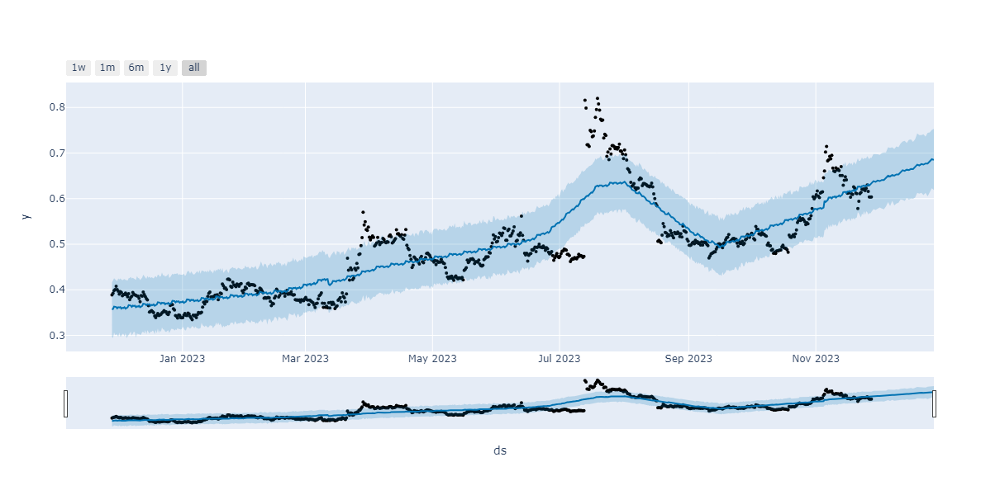

In [21]:
test=['XRP/USDT']

dt='12h'
delta_hrs=12
samples=730
delta_ms=delta_hrs*60*60*1000
now= int(datetime.now().timestamp() * 1000)
start_ms=start_ms=now-(delta_ms)*samples
forecast_dict={}
delta_dict={}
forecast_days=30

for pair in test:
    print(pair)
    try:
        
        # use the ccxt interface to collect last year's data on the exchange
        data=exchange.fetch_ohlcv(pair, dt, start_ms, samples)
        df_m=pd.DataFrame(data)
        df_m.columns=['ms','open','high','low','y','volume']

        # convert the data to prophet format two columns
        df_m['ds']=df_m['ms'].map(lambda x: str(datetime.fromtimestamp(x/1000.0)))
        df_m=df_m[['ds','y']]
        m=0
        m=Prophet()
        m.fit(df_m)
# predict 30 day future = 30*24/12   
        future = m.make_future_dataframe(periods=forecast_days)
        print(future.tail())
        forecast = m.predict(future)
        forecast_dict[pair]=forecast
        print(forecast.shape)

# just cleaning up and asking for a dataframe from last year to next month 
        delta_dict[pair]=list(forecast.loc[0,['yhat','yhat_lower','yhat_upper']]) + list(forecast.loc[759,['yhat','yhat_lower','yhat_upper']])
#    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()
#    print(pair,forecast.loc[399,['yhat','yhat_lower','yhat_upper']])
    
    except:
        sys.stderr.write("ERROR: " + pair + " could not forecast skipping...\n\n")
#plt.clf()
#m.plot(forecast)

# interactive plot
from prophet.plot import plot_plotly, plot_components_plotly
plot_plotly(m, forecast)


# Favorites assets test (manual list)
- full years training data and 30 day forward predict 
- static graphs
- see https://pypi.org/project/prophet/
- python tutorial: https://facebook.github.io/prophet/docs/quick_start.html#python-api
- local test without cluster


AAVE/USDT


09:56:49 - cmdstanpy - INFO - Chain [1] start processing
09:56:49 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


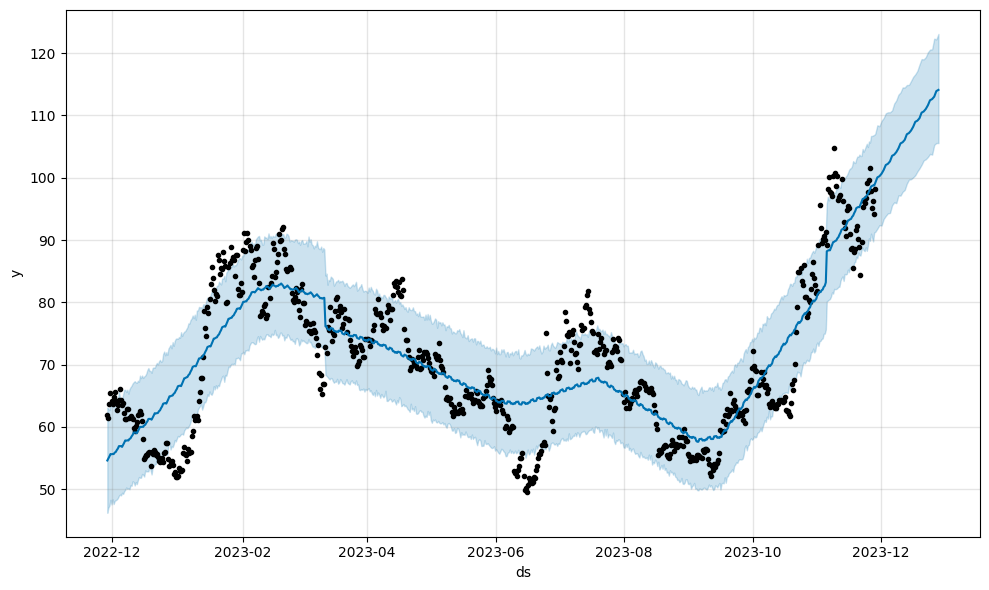

ADA/USDT


09:56:51 - cmdstanpy - INFO - Chain [1] start processing
09:56:51 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


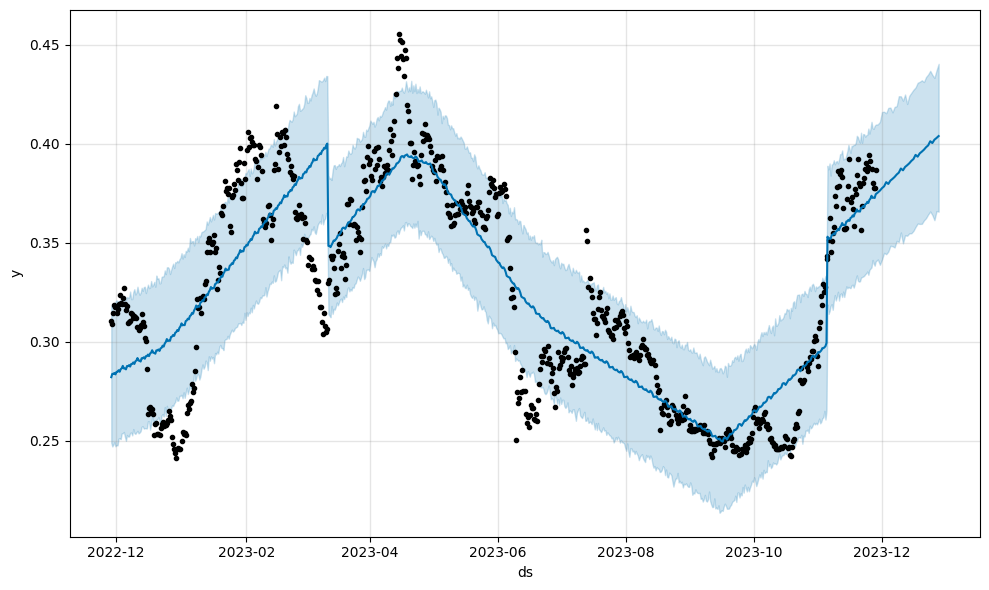

ALGO/USDT


09:56:52 - cmdstanpy - INFO - Chain [1] start processing
09:56:52 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


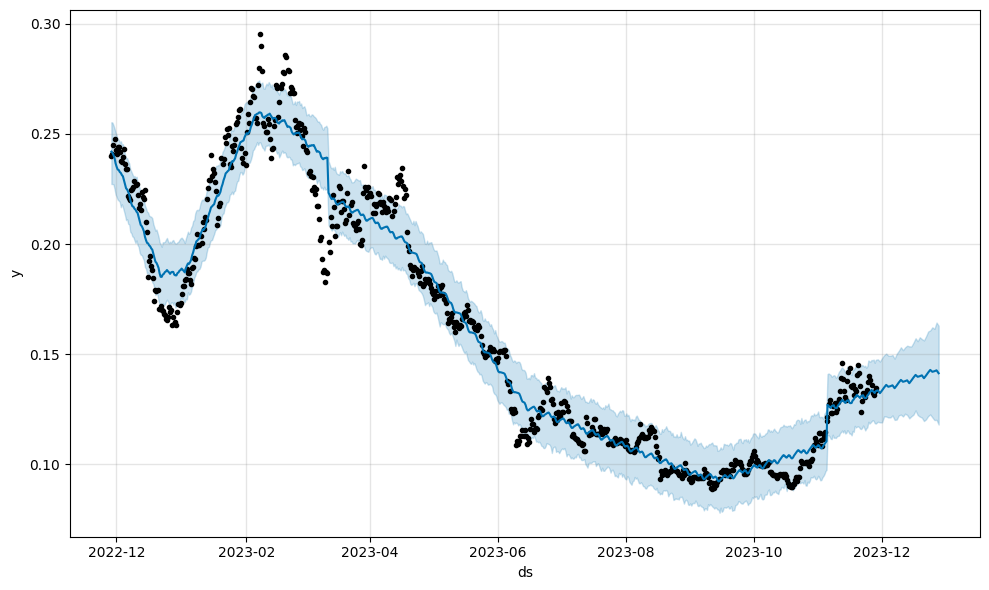

ATOM/USDT


09:56:53 - cmdstanpy - INFO - Chain [1] start processing
09:56:53 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


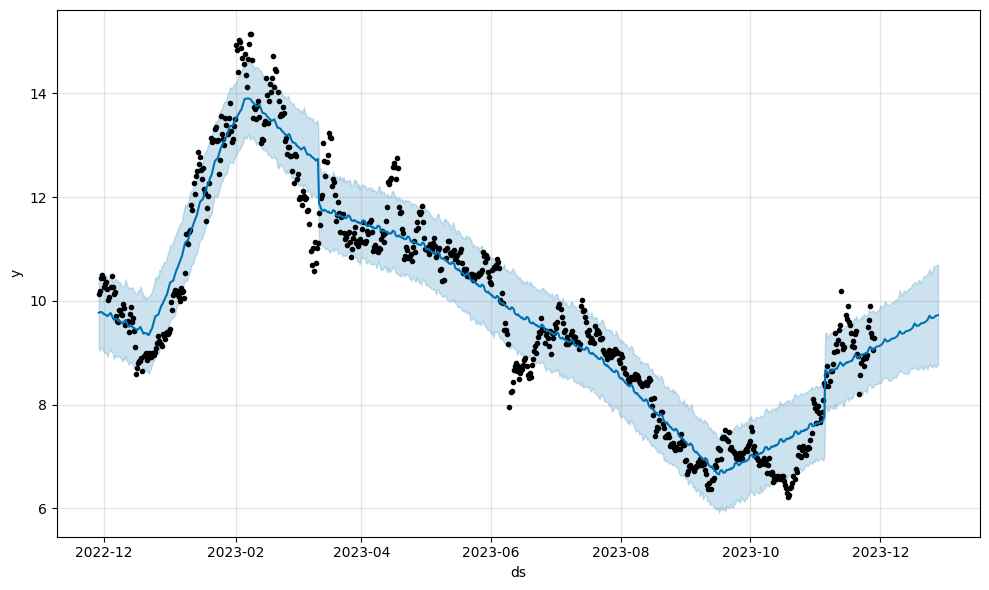

AVAX/USDT


09:56:54 - cmdstanpy - INFO - Chain [1] start processing
09:56:54 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


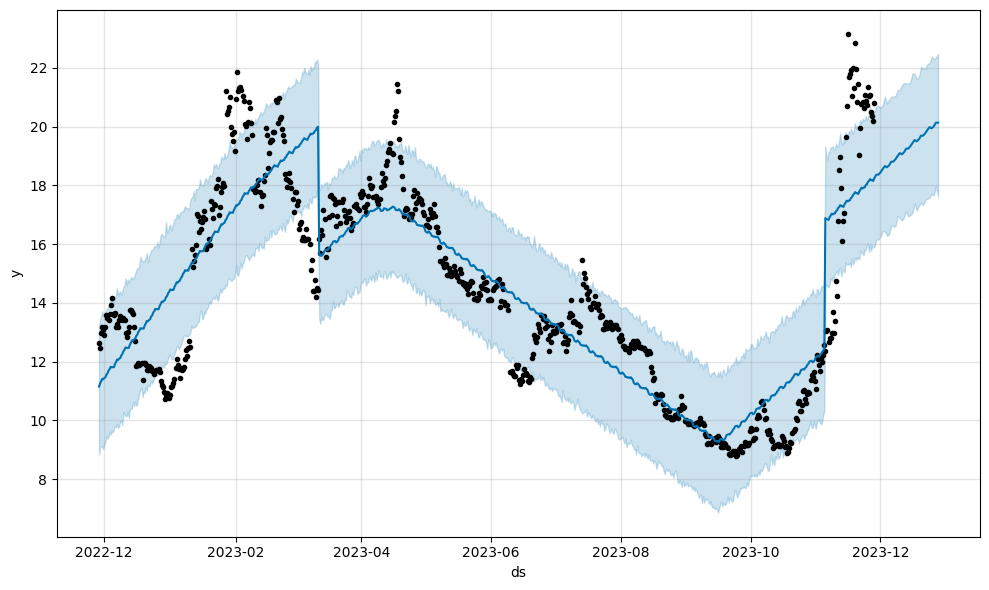

AXS/USDT


09:56:55 - cmdstanpy - INFO - Chain [1] start processing
09:56:56 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


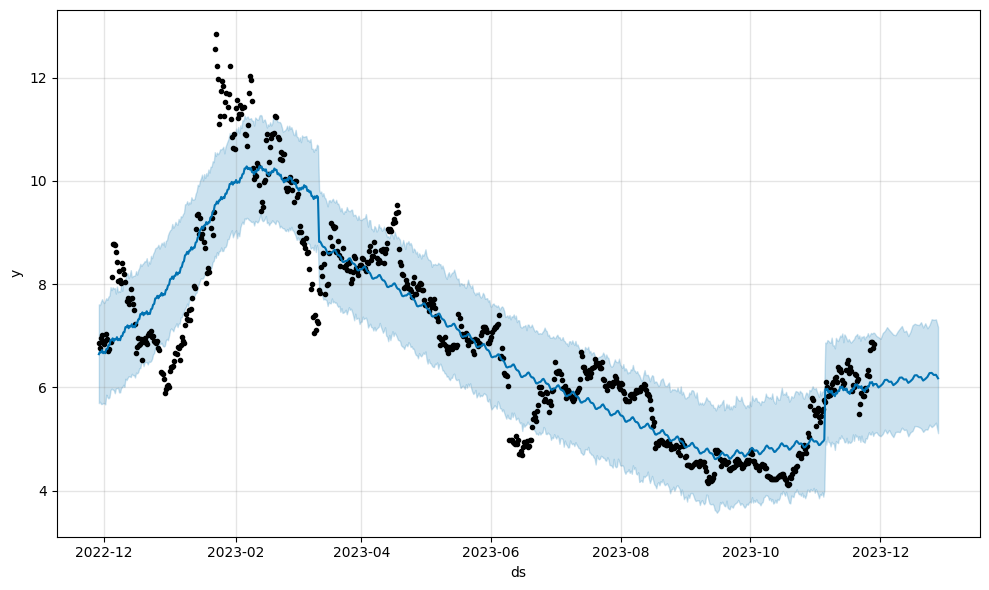

BAT/USDT


09:56:56 - cmdstanpy - INFO - Chain [1] start processing
09:56:57 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


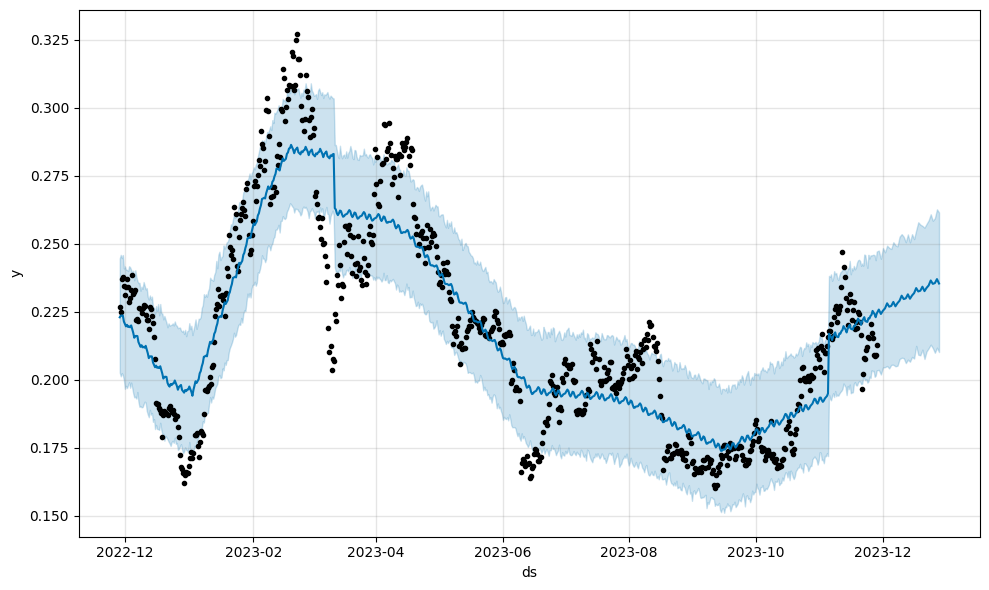

BCH/USDT


09:56:58 - cmdstanpy - INFO - Chain [1] start processing
09:56:58 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


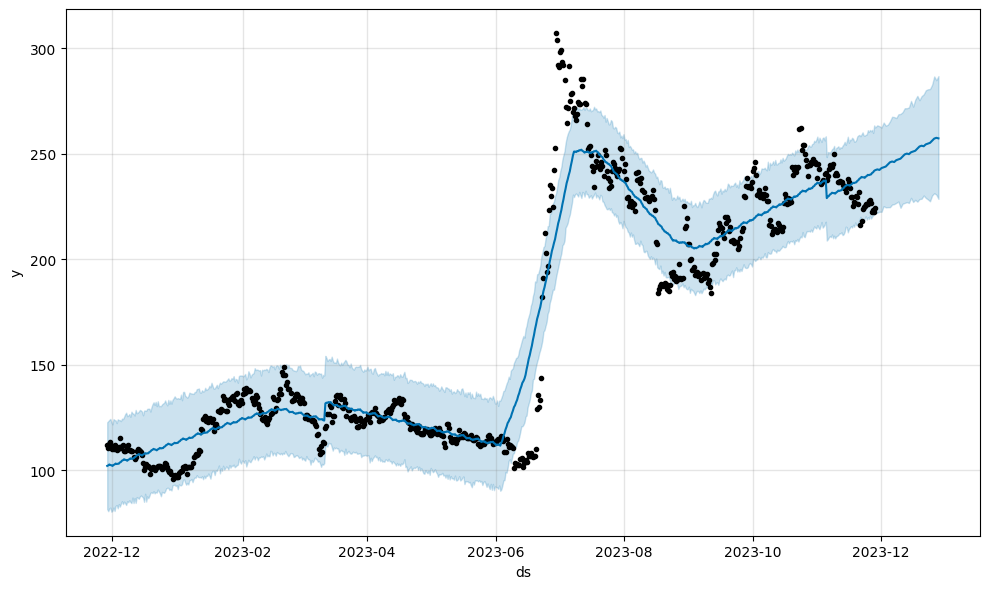

BTC/USDT


09:56:59 - cmdstanpy - INFO - Chain [1] start processing
09:56:59 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


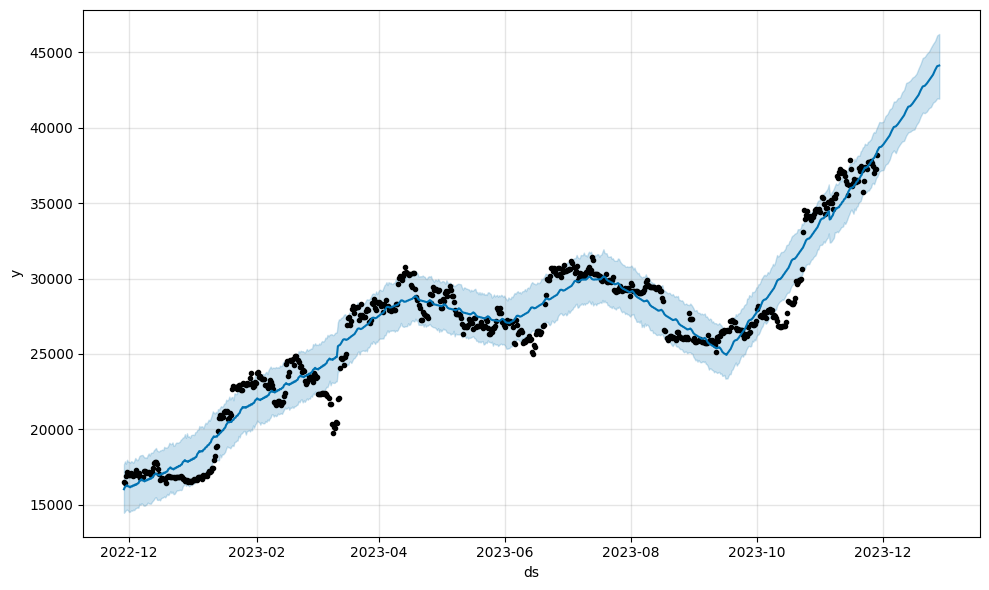

COMP/USDT


09:57:00 - cmdstanpy - INFO - Chain [1] start processing
09:57:01 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


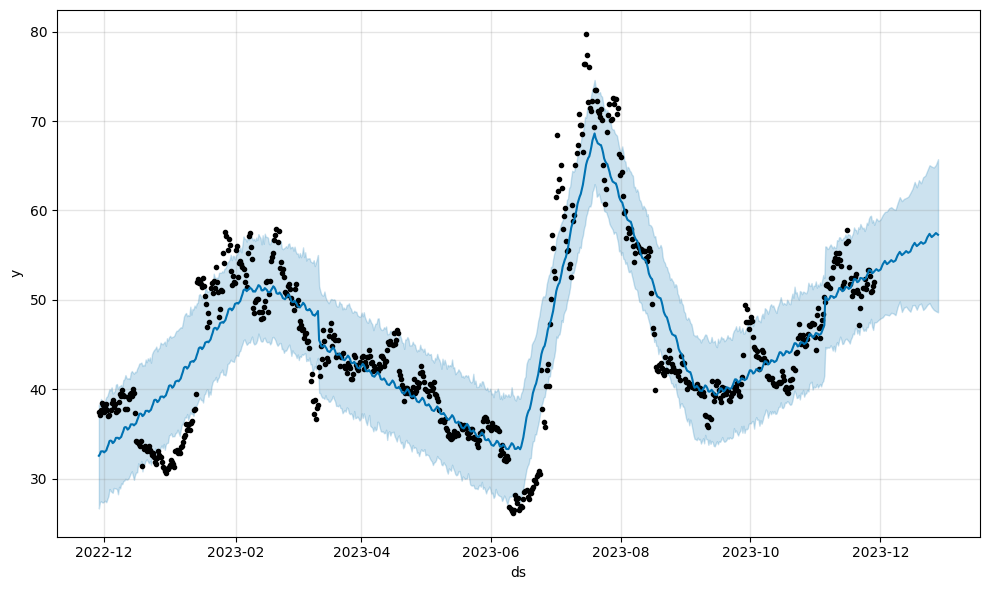

CRV/USDT


09:57:02 - cmdstanpy - INFO - Chain [1] start processing
09:57:02 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


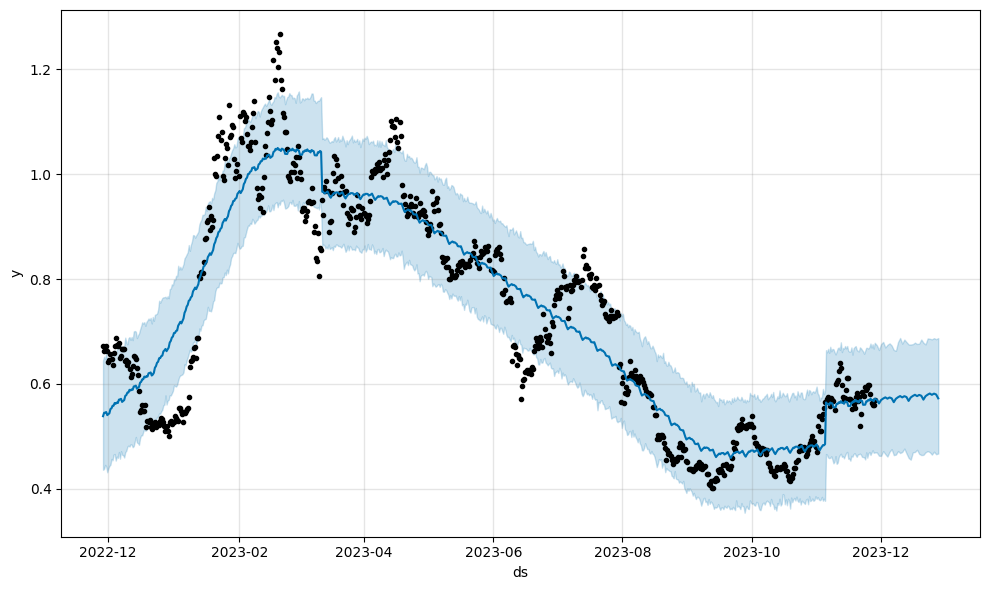

DOGE/USDT


09:57:03 - cmdstanpy - INFO - Chain [1] start processing
09:57:03 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


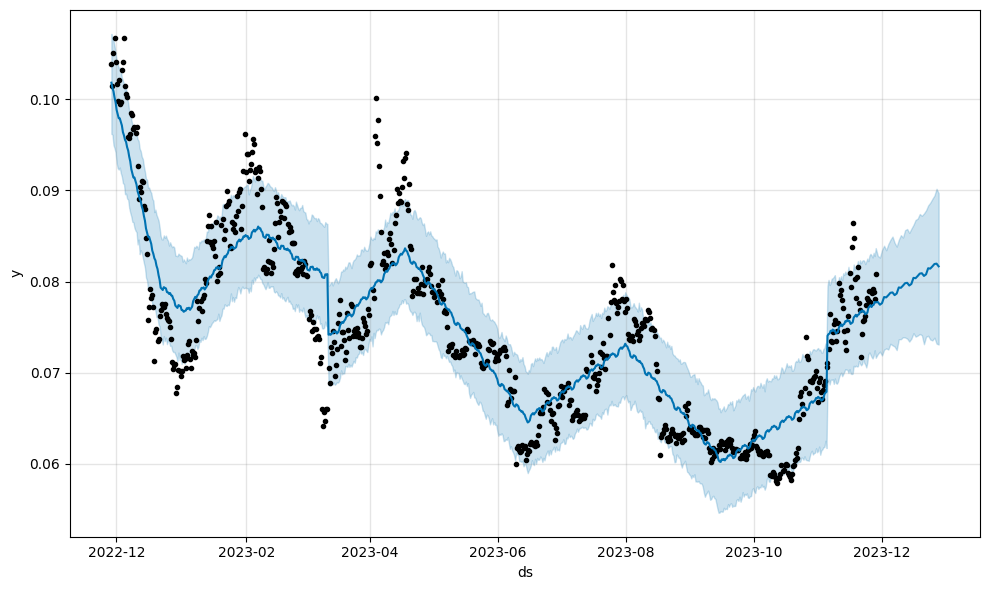

DOT/USDT


09:57:04 - cmdstanpy - INFO - Chain [1] start processing
09:57:04 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


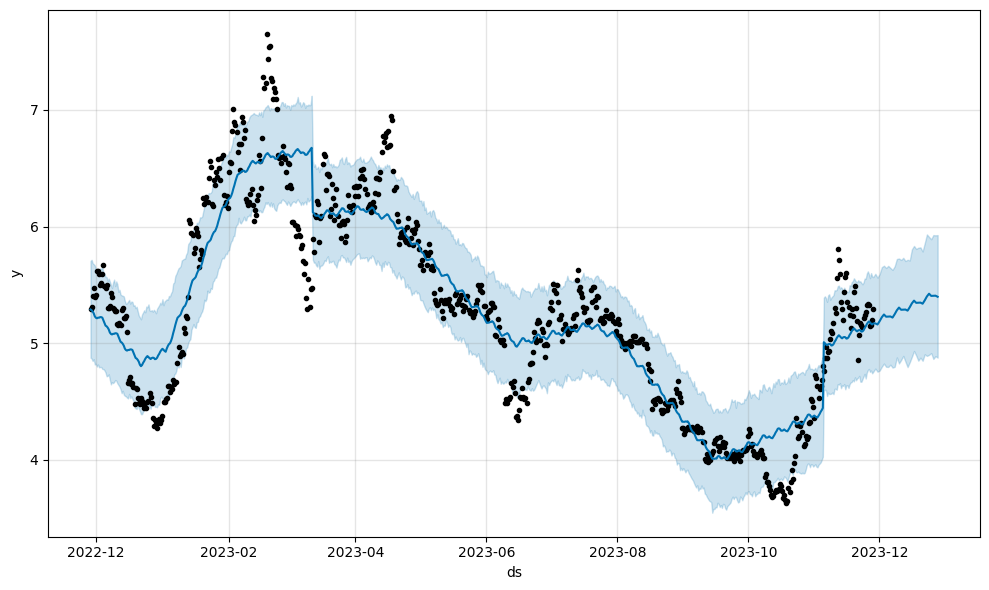

ENJ/USDT


09:57:05 - cmdstanpy - INFO - Chain [1] start processing
09:57:05 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


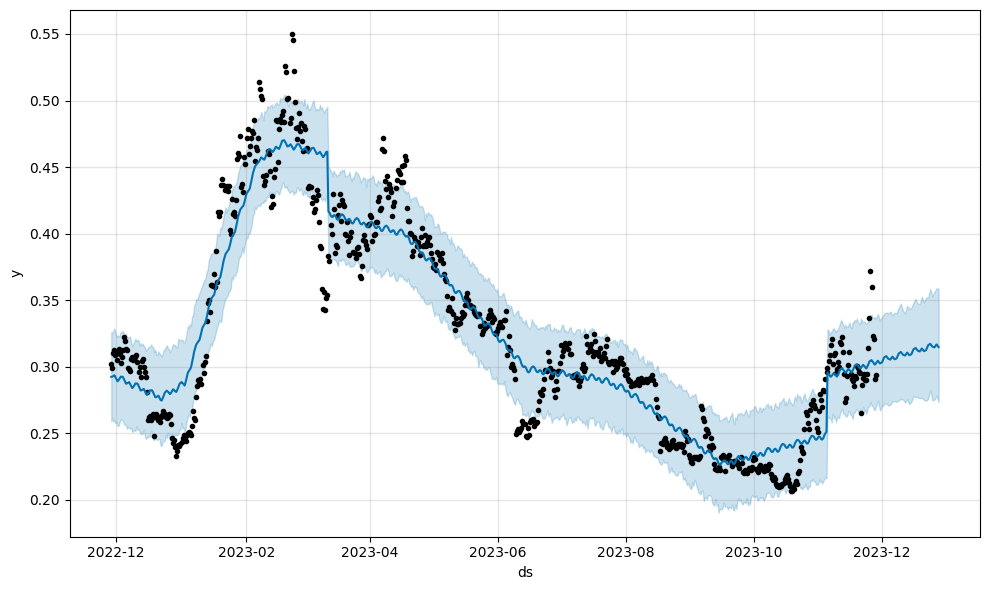

EOS/USDT


09:57:06 - cmdstanpy - INFO - Chain [1] start processing
09:57:06 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


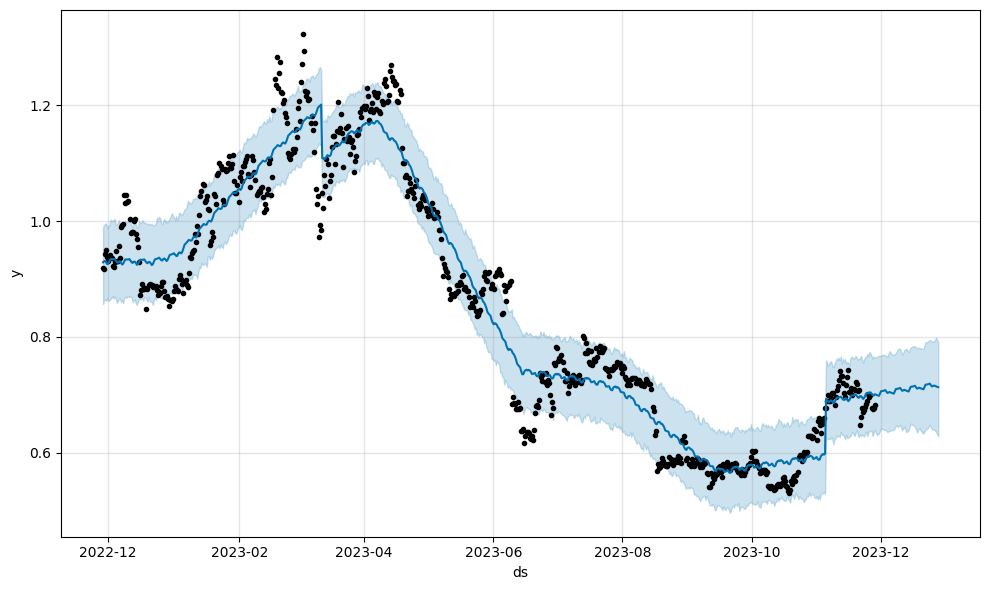

ETH/USDT


09:57:07 - cmdstanpy - INFO - Chain [1] start processing
09:57:07 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


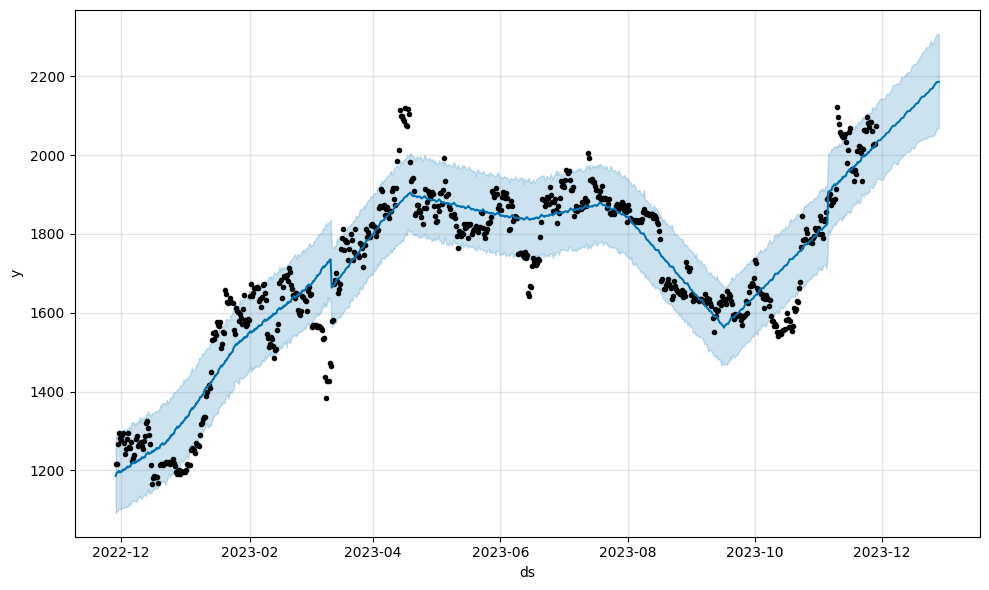

FLOW/USDT


09:57:08 - cmdstanpy - INFO - Chain [1] start processing
09:57:09 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


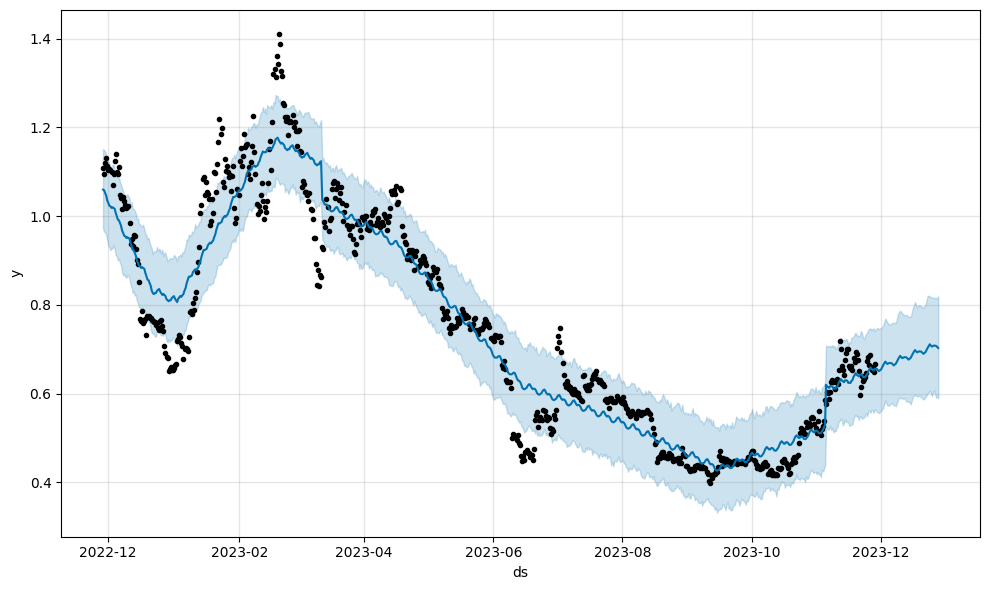

GRT/USDT


09:57:10 - cmdstanpy - INFO - Chain [1] start processing
09:57:10 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


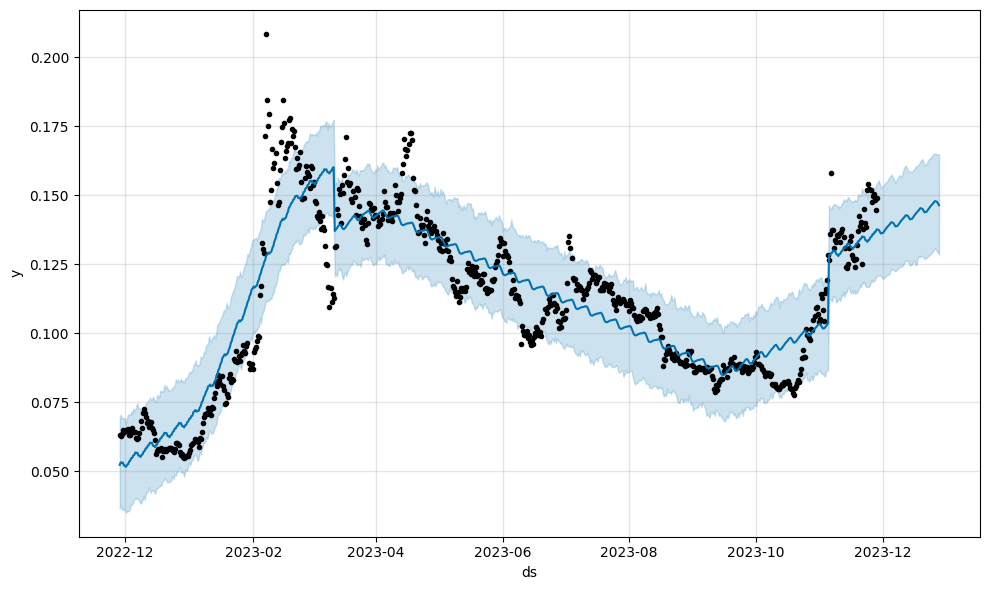

LINK/USDT


09:57:11 - cmdstanpy - INFO - Chain [1] start processing
09:57:11 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


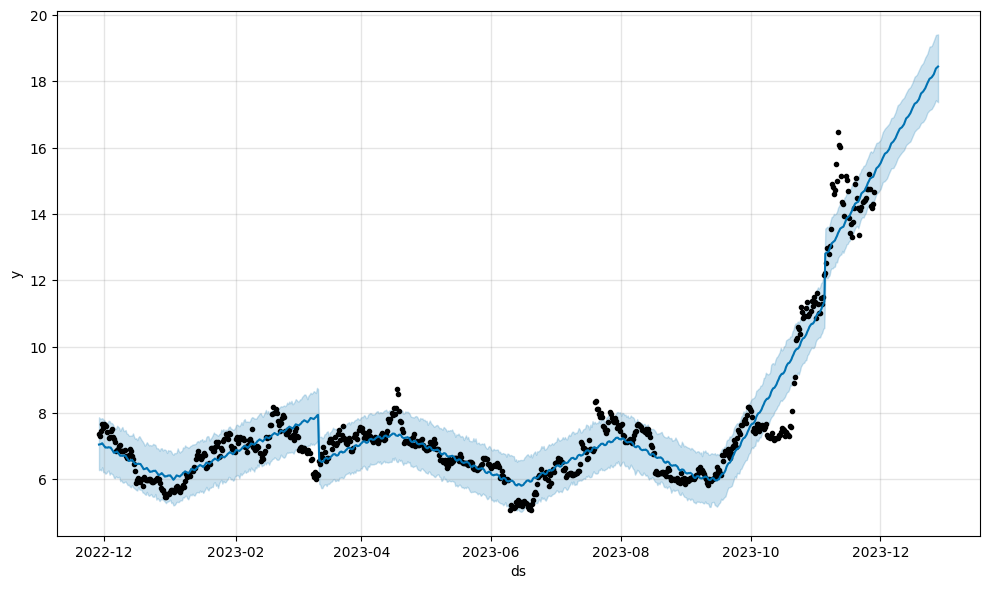

LTC/USDT


09:57:12 - cmdstanpy - INFO - Chain [1] start processing
09:57:12 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


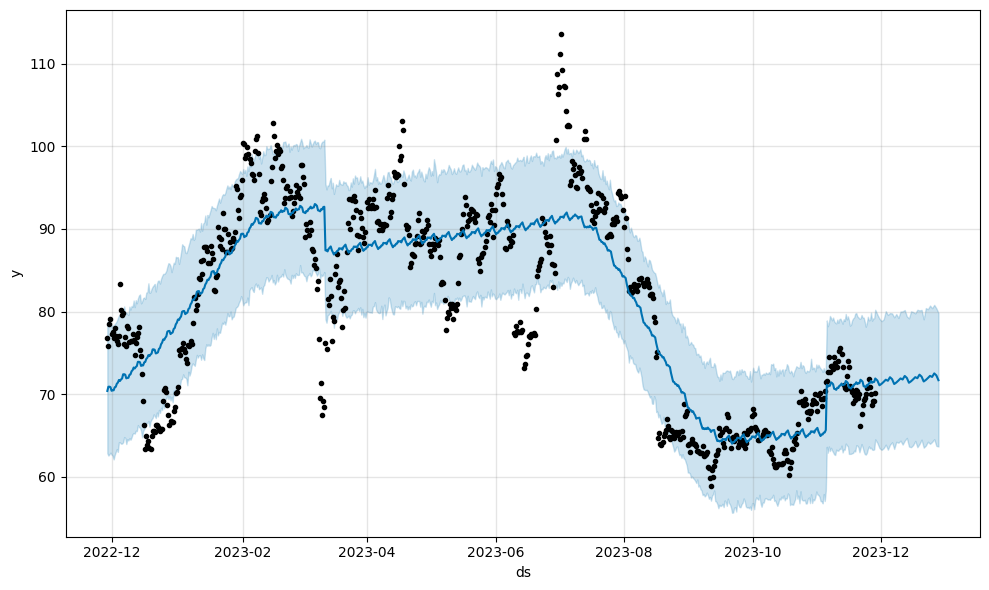

MANA/USDT


09:57:13 - cmdstanpy - INFO - Chain [1] start processing
09:57:13 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


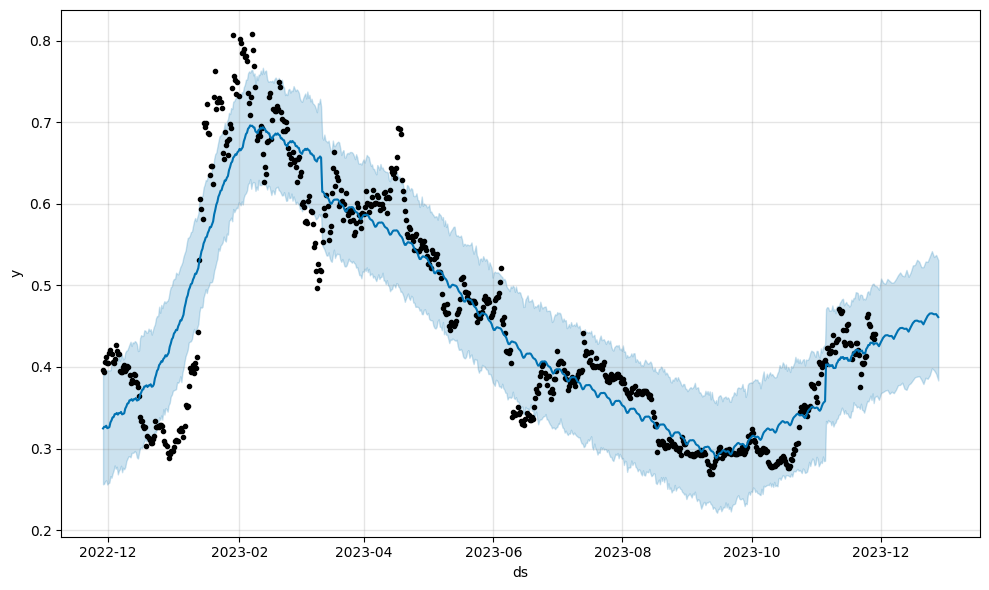

MATIC/USDT


09:57:14 - cmdstanpy - INFO - Chain [1] start processing
09:57:14 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


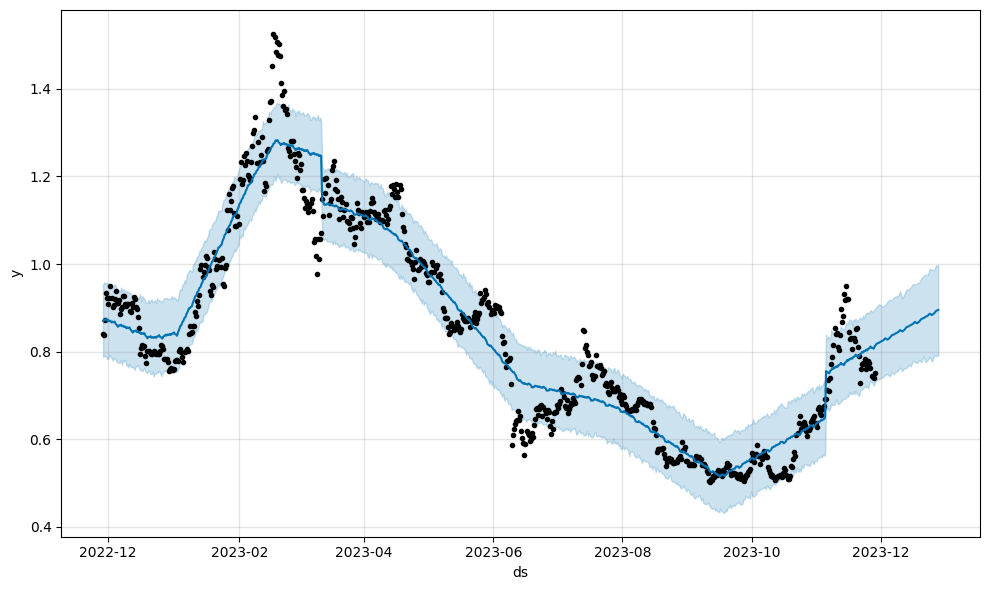

MKR/USDT


09:57:15 - cmdstanpy - INFO - Chain [1] start processing
09:57:15 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


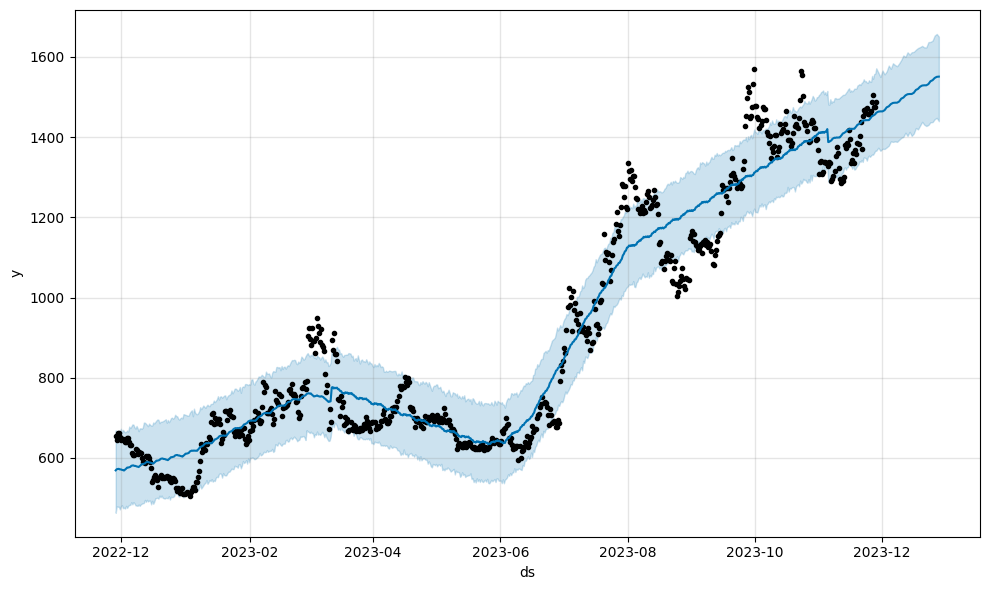

SAND/USDT


09:57:16 - cmdstanpy - INFO - Chain [1] start processing
09:57:16 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


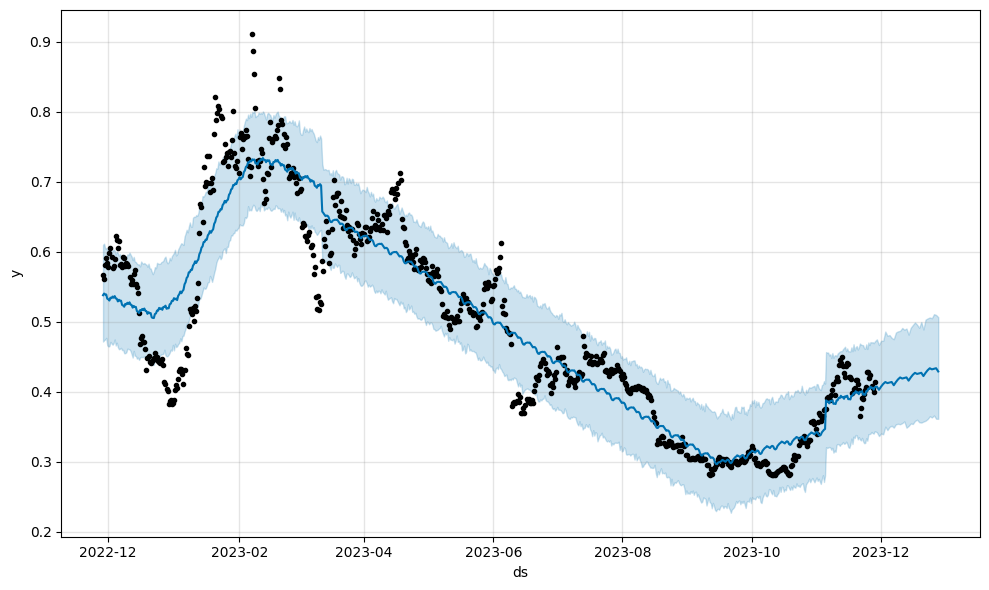

SHIB/USDT


09:57:17 - cmdstanpy - INFO - Chain [1] start processing
09:57:18 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


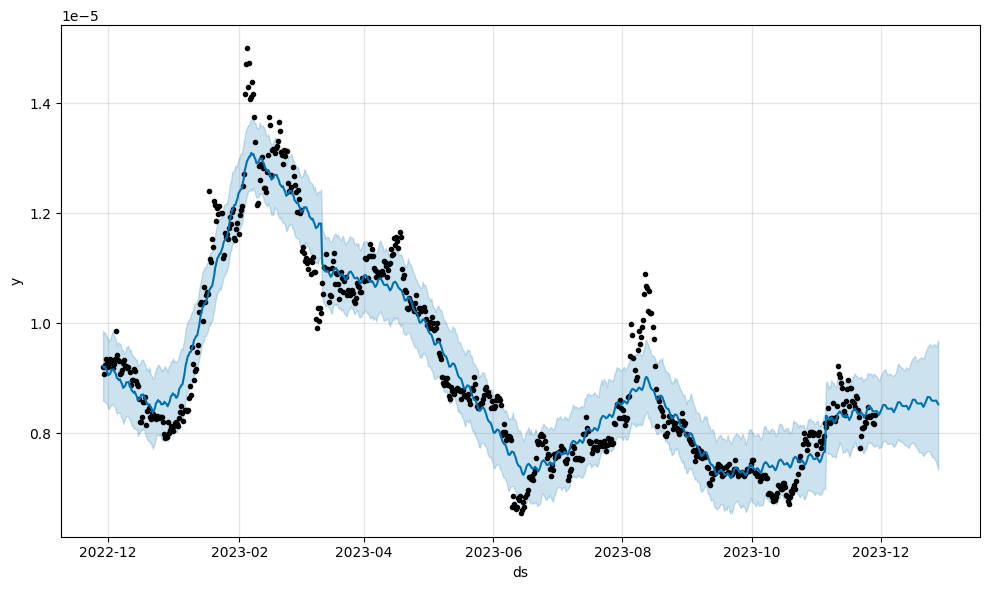

SOL/USDT


09:57:19 - cmdstanpy - INFO - Chain [1] start processing
09:57:19 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


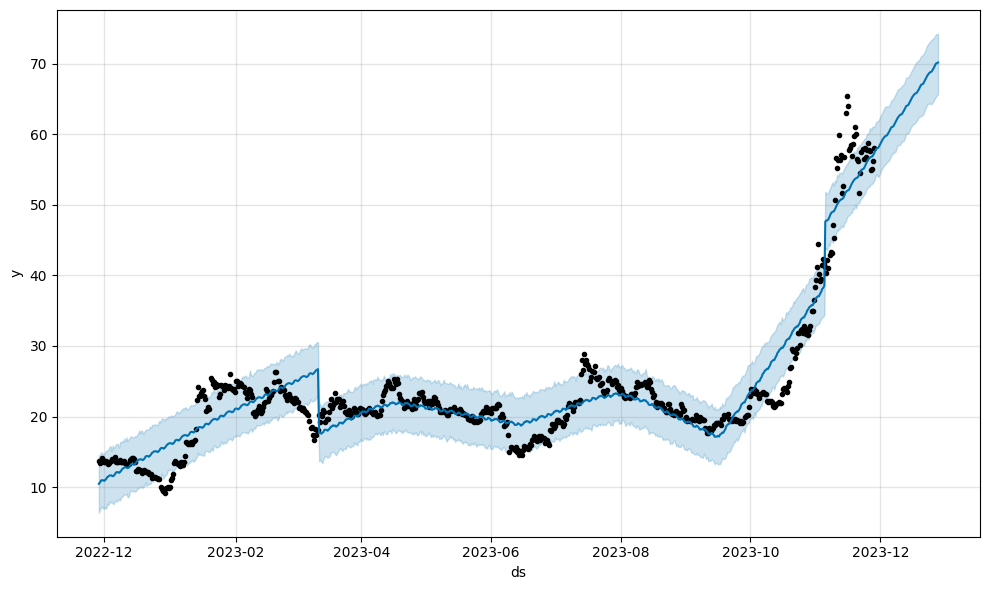

SUSHI/USDT


09:57:20 - cmdstanpy - INFO - Chain [1] start processing
09:57:20 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


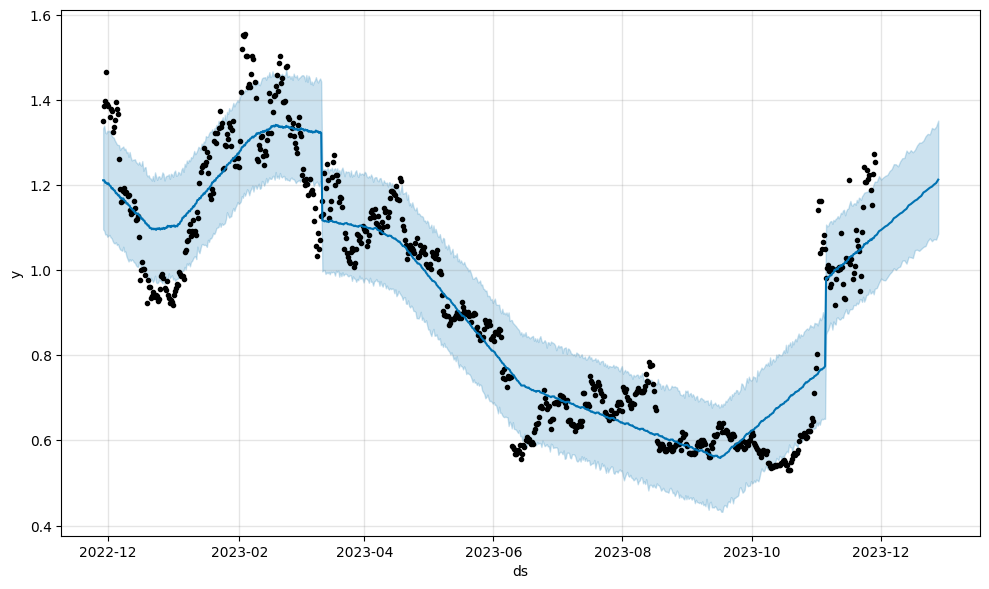

UNI/USDT


09:57:21 - cmdstanpy - INFO - Chain [1] start processing
09:57:21 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


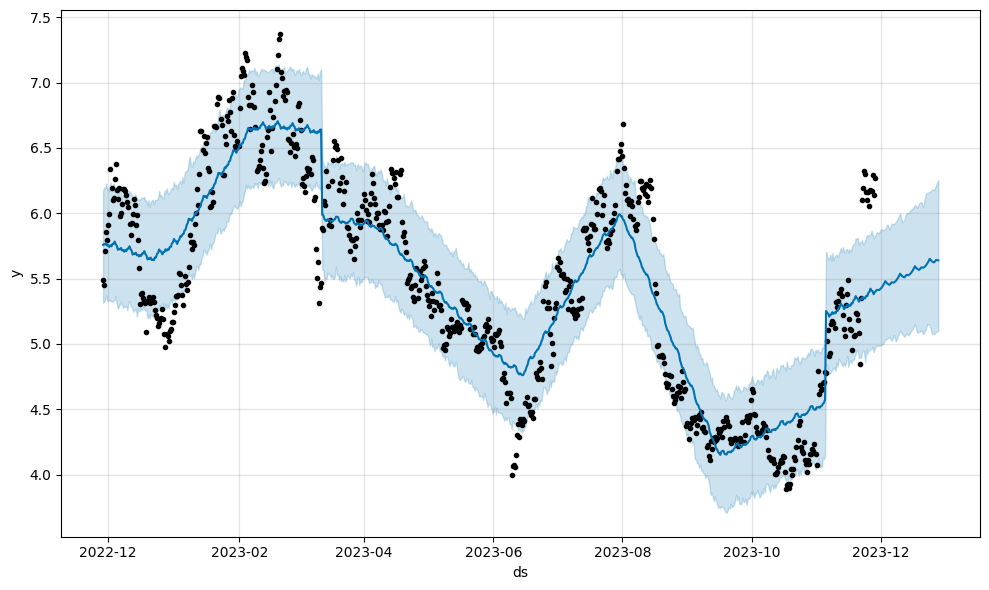

XLM/USDT


09:57:22 - cmdstanpy - INFO - Chain [1] start processing
09:57:22 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


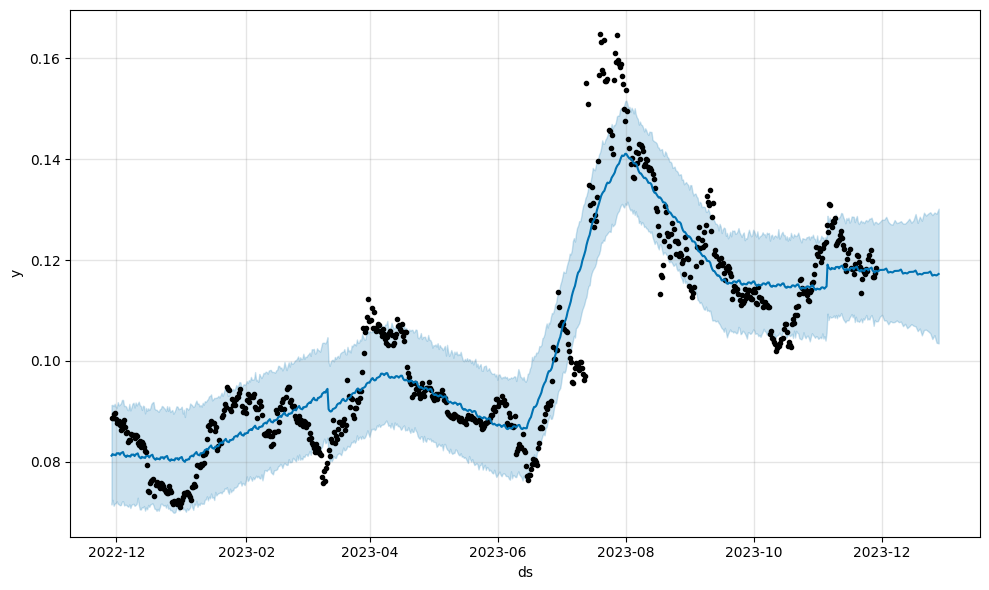

XRP/USDT


09:57:23 - cmdstanpy - INFO - Chain [1] start processing
09:57:23 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


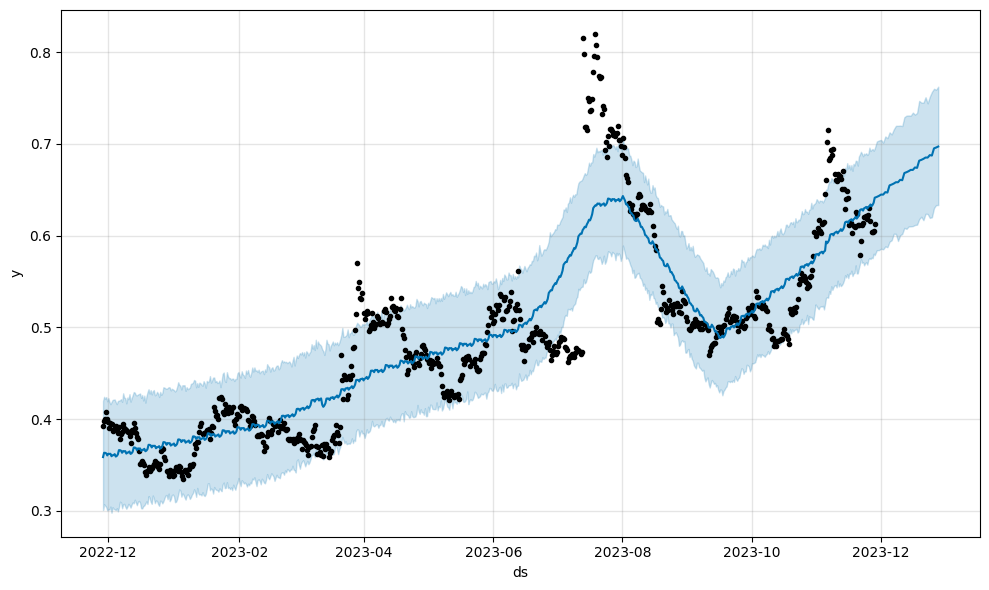

XTZ/USDT


09:57:24 - cmdstanpy - INFO - Chain [1] start processing
09:57:25 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


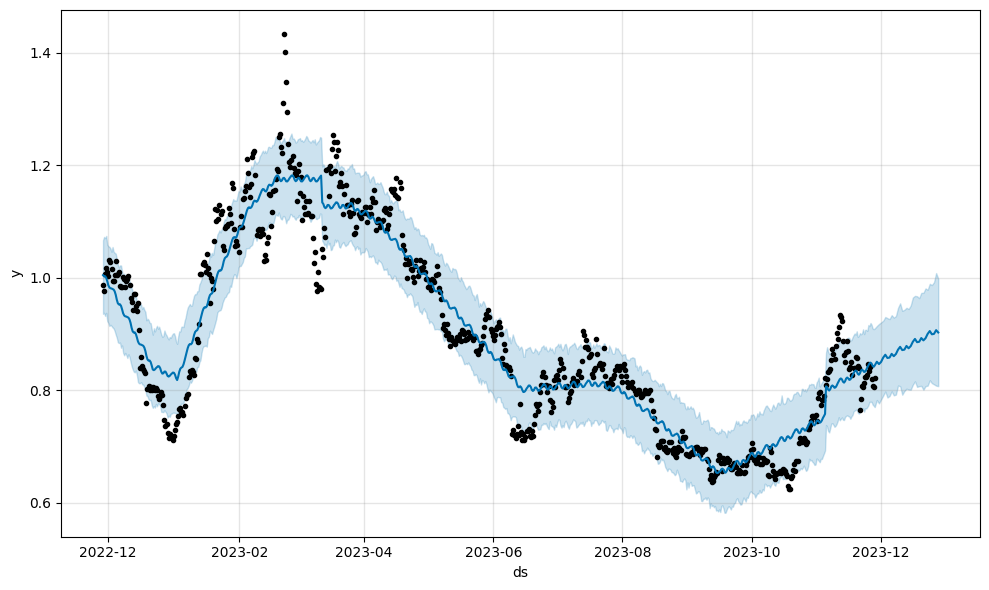

YFI/USDT


09:57:26 - cmdstanpy - INFO - Chain [1] start processing
09:57:26 - cmdstanpy - INFO - Chain [1] done processing


                     ds
755 2023-12-24 04:00:00
756 2023-12-25 04:00:00
757 2023-12-26 04:00:00
758 2023-12-27 04:00:00
759 2023-12-28 04:00:00


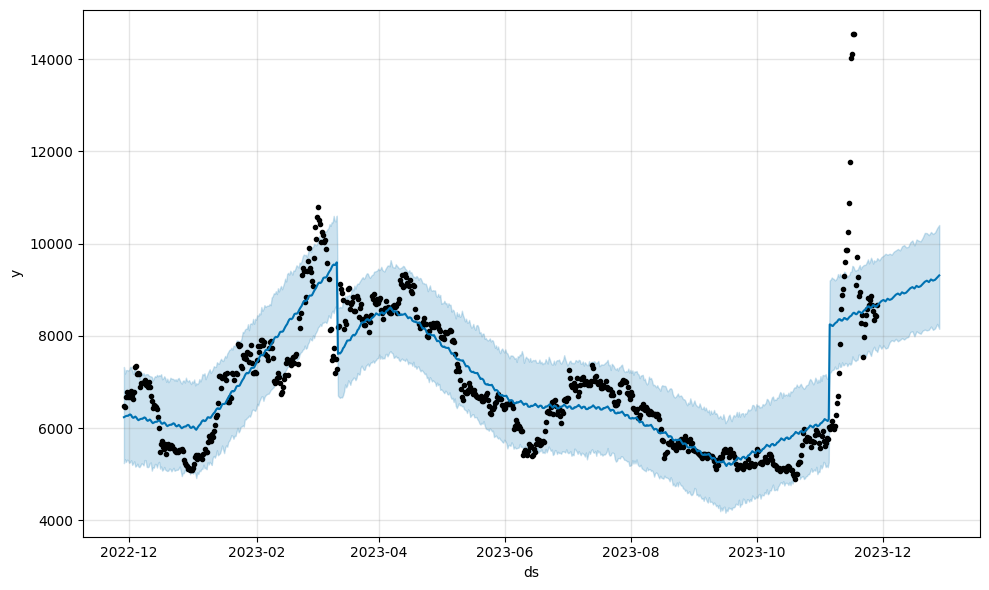

In [193]:
dt='12h'
delta_hrs=12
samples=730
# note last sample is 730 -1 zero indexing...
delta_ms=delta_hrs*60*60*1000
now= int(datetime.now().timestamp() * 1000)
start_ms=start_ms=now-(delta_ms)*samples
forecast_dict={}
delta_dict={}
forecast_days=30

for pair in ASSET_PAIRS:
    print(pair)
    try:
        
        # use the ccxt interface to collect last year's data on the exchange
        data=exchange.fetch_ohlcv(pair, dt, start_ms, samples)
        df_m=pd.DataFrame(data)
        df_m.columns=['ms','open','high','low','y','volume']

        # convert the data to prophet format two columns
        df_m['ds']=df_m['ms'].map(lambda x: str(datetime.fromtimestamp(x/1000.0)))
        df_m=df_m[['ds','y']]
        m=Prophet()
        m.fit(df_m)
# predict 30 day future = 30*24/12   
        future = m.make_future_dataframe(periods=forecast_days)
        print(future.tail())
        forecast = m.predict(future)
        forecast_dict[pair]=forecast
        m.plot(forecast)
        plt.show()


# just cleaning up and asking for a dataframe from last year to next month 
        delta_dict[pair]=list(forecast.loc[670,['yhat','yhat_lower','yhat_upper']]) + list(forecast.loc[729,['yhat','yhat_lower','yhat_upper']])
#    forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()
#    print(pair,forecast.loc[399,['yhat','yhat_lower','yhat_upper']])
    
    except:
        sys.stderr.write("ERROR: " + pair + " could not forecast skipping...\n\n")  

# Comprehensive (every single Asset) Test 
- skipping by setting to raw
- not local - uses cluster

# Process the Prophet results
- Ensure names and add a Fold Change column to the time series for comparisons 
- (note: could be any time series result, crypto, transcript FC, gene frequency, population size ... ) 

In [23]:
delta_df=pd.DataFrame.from_dict(delta_dict,orient='index')
delta_df.columns=['yhat_s','yhat_lower_s','yhat_upper_s','yhat_e','yhat_lower_e','yhat_upper_e']
delta_df['FC']=delta_df['yhat_e']/delta_df['yhat_s']

# Top 100 Time series Fold-Change predictions

,yhat_s,yhat_lower_s,yhat_upper_s,yhat_e,yhat_lower_e,yhat_upper_e,FC,base
SOL/USDT,35.576306,31.485674,39.398752,56.958719,52.949733,60.962626,1.601030,SOL
AVAX/USDT,11.927677,9.753984,14.037002,18.015176,15.558490,20.046535,1.510368,AVAX
SUSHI/USDT,0.736331,0.606186,0.858537,1.067581,0.940077,1.191107,1.449866,SUSHI
LINK/USDT,10.639712,9.892947,11.392893,15.115670,14.321765,15.867954,1.420684,LINK
YFI/USDT,6055.350724,5068.874809,7102.168725,8597.605238,7571.066339,9541.141882,1.419836,YFI
GRT/USDT,0.101403,0.084795,0.117028,0.136474,0.120534,0.153429,1.345863,GRT
MATIC/USDT,0.633574,0.552277,0.718043,0.808852,0.728169,0.890255,1.276650,MATIC
ADA/USDT,0.292001,0.257769,0.326595,0.371228,0.333094,0.404906,1.271327,ADA
FLOW/USDT,0.510103,0.413197,0.602674,0.648400,0.562658,0.745390,1.271116,FLOW
AAVE/USDT,80.046877,72.409688,87.623977,98.797758,91.374198,106.765752,1.234249,AAVE


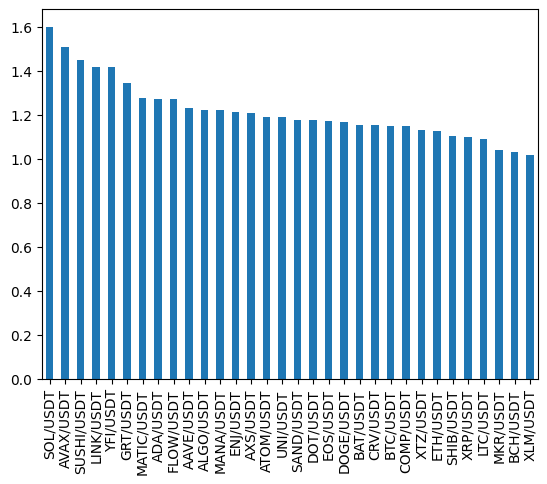

In [24]:
delta_df.sort_values(by='FC',ascending=False,inplace=True)
delta_df['base']=delta_df.index.map(lambda x: x.split('/')[0])
delta_df=delta_df[delta_df['base'].map(lambda x: (not x.endswith('3L'))&(not x.endswith('3S')))]
delta_df[delta_df['FC']>1.0]['FC'].plot(kind='bar')
delta_df.head(100)

# 3. BEGIN Fractional Change Ranks Analysis

- run a [12|24|72] hour poll on the cluster for the kucoin exchange
- uses the notebook's SBC cluster instance on the LAN
- next is get_ohlcv_df fuinction a CCXT API function to get open high low close and volume data

In [25]:
# 13 24hr samples is 12 hours 25 samples is 24 hrs ... like that
# nSamples/nHrs 
def get_ohlcv_df(base,**kwargs):
    quote=kwargs.get("q","USDT")
    # hours + 1 
    # 3day=73 1day=25 12hr=13 6hr=7 
    samples=kwargs.get("number",73)
    # hours
    delta_hrs=kwargs.get("delta",6)
    delta_ms=delta_hrs*60*60*1000
    now= int(datetime.now().timestamp() * 1000)
    start_ms=now-(delta_ms)*samples
    max_candles=samples
#    base='MATIC'
 #   quote='USDT'
    pair=str(base) + "/" + str(quote)
    dt=str(delta_hrs) + "h"
    exchange = ccxt.kucoin({
    'enableRateLimit': True,
    })
    tries=3
    done=False
    while done==False:
        try:
            data=exchange.fetch_ohlcv(pair, dt, start_ms, max_candles)
            df=pd.DataFrame(data)
            df.columns=['ms','open','high','low','close','volume']
            df['time']=df['ms'].map(lambda x: datetime.fromtimestamp(int(x)/1000).isoformat())
            df['span']=(df['high']-df['low'])/df['close']
            df['run']=(df['close']-df['open'])/df['close']
            df['base']=base
            df['quote']=quote
            df.set_index(['time','base','quote'],inplace=True)
            time.sleep(20)
            done=True
            return df
        except:
            time.sleep(20)
            if tries==3:
                done=True
                return None
            else:
                tries+=1

# Test the cluster and api

In [97]:
x=notebook_client.submit(get_ohlcv_df,'XRP')

In [98]:
x

<Future: pending, key: get_ohlcv_df-b35b4167123e040dd7ac3f909f7e06f4>

In [159]:
x.result().head(3)

,,,ms,open,high,low,close,volume,span,run
time,base,quote,,,,,,,,
2023-11-10T04:00:00,XRP,USDT,1699617600000,0.66085,0.66239,0.63599,0.65833,1.586243e+07,0.040101,-0.003828
2023-11-10T10:00:00,XRP,USDT,1699639200000,0.65814,0.66485,0.65614,0.65931,7.613748e+06,0.013211,0.001775
2023-11-10T16:00:00,XRP,USDT,1699660800000,0.65939,0.66508,0.63962,0.65233,1.011565e+07,0.039029,-0.010823


# Process Fold Change on all coins (parallelized)

In [29]:
# sets up the jobs as futures in OHLCVs variable
OHLCVs = notebook_client.map(get_ohlcv_df, coins)
# grabs the results in df_list
df_list=notebook_client.gather(OHLCVs)
# force clear memory for the completed futures on the SBC 
[x.cancel() for x in OHLCVs]
# simplifies the data using cluster
list_future=notebook_client.map(df2closeNclicks,df_list)
#df_list='.'
join_list=notebook_client.gather(list_future)
# force clear memory for the completed futures on the SBC
[x.cancel() for x in list_future]
processed_list=list(filter(not_null,join_list))

In [30]:
# try using recursive a tree approach on the cluster next 
total_df=reduce(join_two,processed_list)
#processed_list='.'
pct_change_df=total_df.pct_change()
pct_change_df.drop([0], inplace = True )

In [31]:
pct_change_df.shape

(72, 797)

In [32]:
pct_change_df.columns

Index(['1EARTH', '1INCH', 'AAVE', 'AAVE3L', 'AAVE3S', 'ABBC', 'ACA', 'ACE',
       'ACH', 'ACQ',
       ...
       'YLD', 'ZBC', 'ZCX', 'ZEC', 'ZEE', 'ZELIX', 'ZEN', 'ZIL', 'ZPAY',
       'ZRX'],
      dtype='object', length=797)

# Convert to percent change Ranks and cumulative sums
- Longs and Shorts
- stratifies out long and short purchase behavior

In [33]:
ranks_df=pct_change_df.describe().T[['mean']].sort_values(by='mean',ascending=False).reset_index()
ranks3L_df=ranks_df[ranks_df['index'].map(lambda x: x.endswith('3L'))].copy()
ranks3L_df['base']=ranks3L_df['index'].map(lambda x: x[:-2])
ranks3S_df=ranks_df[ranks_df['index'].map(lambda x: x.endswith('3S'))].copy()
ranks3S_df['base']=ranks3S_df['index'].map(lambda x: x[:-2])

In [34]:
ranks3L_df[ranks3L_df['mean']>0]

,index,mean,base
17,AVAX3L,0.016942,AVAX
43,REV3L,0.011696,REV
58,SUSHI3L,0.010383,SUSHI
62,GMT3L,0.010223,GMT
92,NEAR3L,0.007639,NEAR
103,UNI3L,0.007229,UNI
156,APE3L,0.004809,APE
167,SOL3L,0.004634,SOL
173,AXS3L,0.004561,AXS
255,GALAX3L,0.002804,GALAX


array([[<Axes: title={'center': 'mean'}>]], dtype=object)

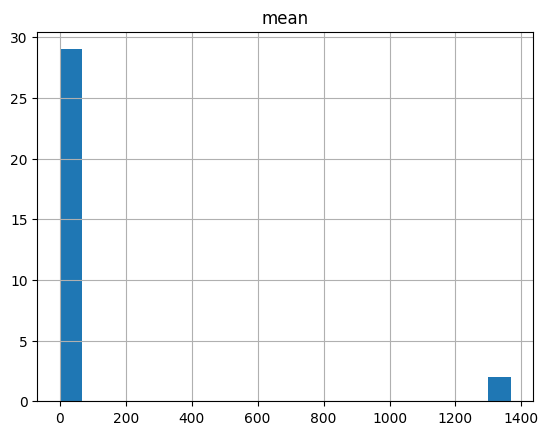

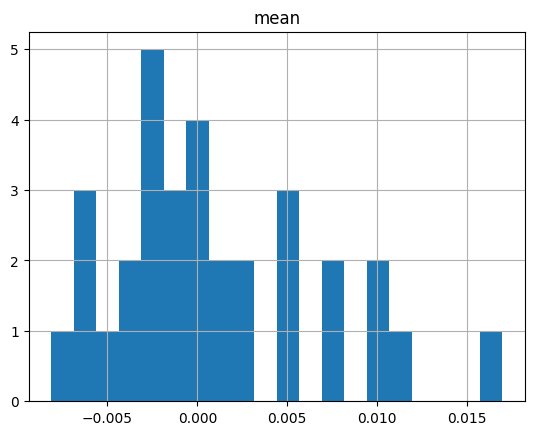

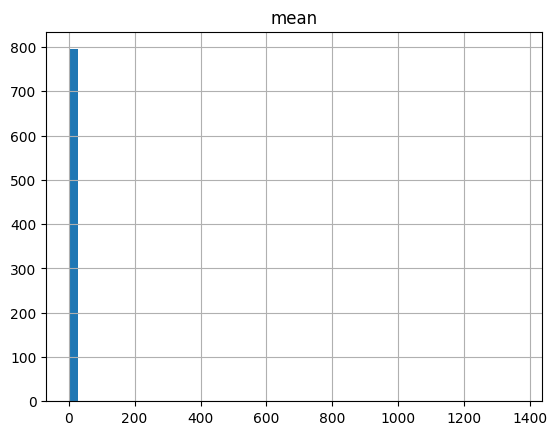

In [35]:
ranks3S_df[['mean']].hist(bins=20)
ranks3L_df[['mean']].hist(bins=20)
ranks_df[['mean']].hist(bins=50)

In [36]:
longs=list(ranks3L_df[ranks3L_df['mean']>0.00]['index'])
shorts=list(ranks3S_df[ranks3S_df['mean']<0.00].sort_values(by='mean')['index'])

In [37]:
picksLS=sorted(list(set(longs[:6]+shorts[:6])))

In [38]:
picksLS

['AVAX3L',
 'AVAX3S',
 'AXS3S',
 'GMT3L',
 'GMT3S',
 'NEAR3L',
 'NEAR3S',
 'REV3L',
 'SUSHI3L',
 'SUSHI3S',
 'UNI3L',
 'UNI3S']

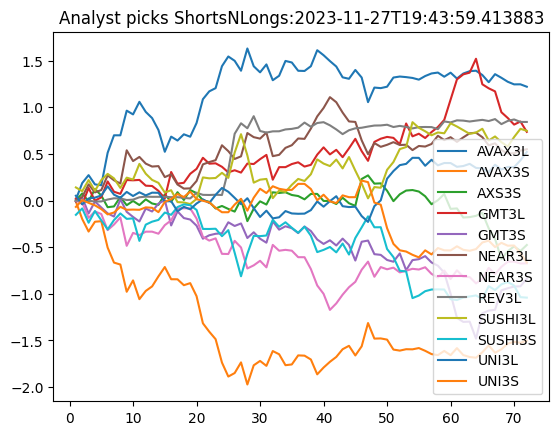

In [39]:
pct_change_df[picksLS].cumsum().plot()
title="Analyst picks ShortsNLongs:" + titleDate
plt.title(title)
file=title+'.png'
#plt.savefig(os.path.join(workingDir,file))


In [40]:
# longs shorts picks EOS, ATOM, BCH,ETH
ranks3L_df='.'
ranks3S_df='.'

# Non-leveraged Assets...

In [41]:
ranks_base_df=ranks_df[ranks_df['index'].map(lambda x: (not x.endswith('3L'))&(not x.endswith('3S')))]

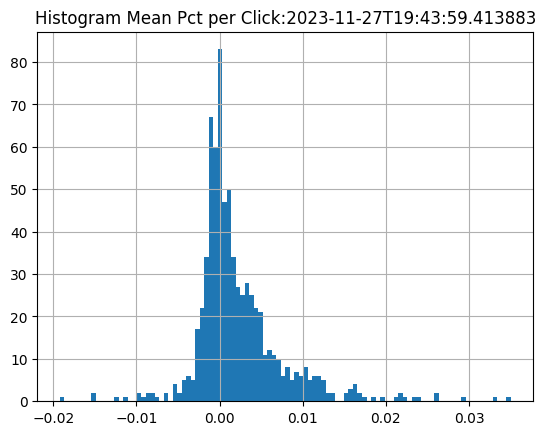

In [42]:
ranks_base_df['mean'].hist(bins = 100)
title="Histogram Mean Pct per Click:" + titleDate
plt.title(title)
file=title+'.png'
#plt.savefig(os.path.join(workingDir,file))

# postive mode indicates a Bull Market 
- this is a double exponential distribution 
- ~ Laplace Distribution

# Gainers - DASH proto

In [43]:
c=int(len(ranks_base_df.index)*0.01)
gainers=ranks_base_df[ranks_base_df['mean']>0.00].sort_values(by='mean',ascending=False)[0:c]

In [44]:
gainers

,index,mean
2,VISION,0.035025
3,LIKE,0.033311
4,HMND,0.029515
5,TSUGT,0.026019
6,AIOZ,0.025925
7,SIDUS,0.024177
8,EOSC,0.023456


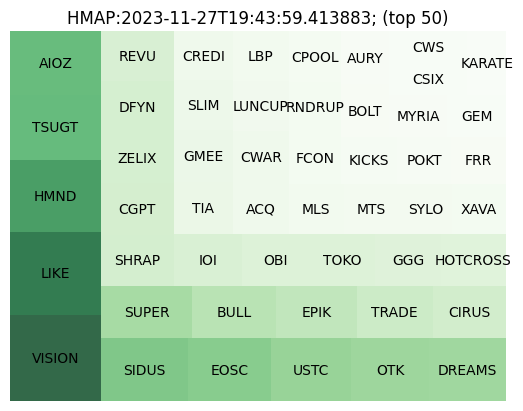

In [45]:
# Gainers
limit=50
q = list(ranks_base_df[ranks_base_df['mean']>0.0].sort_values(by='mean',ascending=False)['mean'])[0:limit]
l = list(ranks_base_df[ranks_base_df['mean']>0.0].sort_values(by='mean',ascending=False)['index'])[0:limit]
#l=[] 
#for i in df.index:
#    l.append(str(df.loc[i,'index']) + "|" + str(df.loc[i,'mean'])[0:6]) 
cmap = matplotlib.cm.Greens
mini=min(q)
maxi=max(q)

norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
fig = plt.figure()
plt.figure().clear()
plt.close()
plt.cla()
plt.clf()
colors = [cmap(norm(value)) for value in q]
squarify.plot(sizes=q,label=l, alpha=.8, color=colors)
plt.axis('off')
title="HMAP:" + titleDate + "; (top " + str(limit) + ")"
plt.title(title)
file=title+'.png'
#plt.savefig(os.path.join(workingDir,file))
plt.show()
plt.close()


## Lots a gaming related Assets ...

# Losers - DASH proto

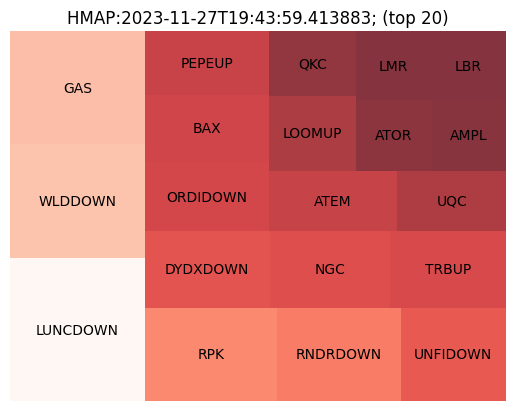

In [46]:
# Losers
limit=20
q = list(ranks_base_df[ranks_base_df['mean']<0.0].sort_values(by='mean',ascending=True)['mean'])[0:limit]
l = list(ranks_base_df[ranks_base_df['mean']<0.0].sort_values(by='mean',ascending=True)['index'])[0:limit]
#l=[] 
#for i in df.index:
#    l.append(str(df.loc[i,'index']) + "|" + str(df.loc[i,'mean'])[0:6]) 
cmap = matplotlib.cm.Reds
mini=min(q)
maxi=max(q)

norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
fig = plt.figure()
plt.figure().clear()
plt.close()
plt.cla()
plt.clf()
colors = [cmap(norm(value)) for value in q]
squarify.plot(sizes=q,label=l, alpha=.8, color=colors)
plt.axis('off')
title="HMAP:" + titleDate + "; (top " + str(limit) + ")"
plt.title(title)
file=title+'.png'
#plt.savefig(os.path.join(workingDir,file))
plt.show()
plt.close()

## SHORT Sellers are loosing some Non-leveraged assets to follow up on...

# Pick top 10% and inspect the recent Fold Change patterns 
- a manual review
- avoid non-linearity with low MC
- Low MC and non-linearity indicates Social Media Pump activity 
- scope here for class discrimination Tether, Gaming, metaverse, deFI, contracts, sidechain, security, service   ...

In [47]:
c=int(len(ranks_base_df.index)*0.1)
picks_df=ranks_base_df[ranks_base_df['mean']>0.0].sort_values(by='mean',ascending=False)[0:c]

VISION


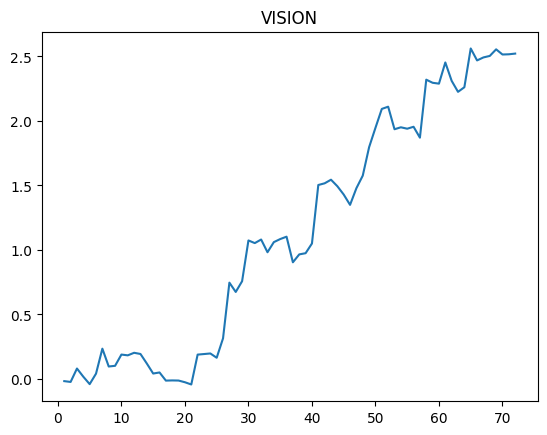

LIKE


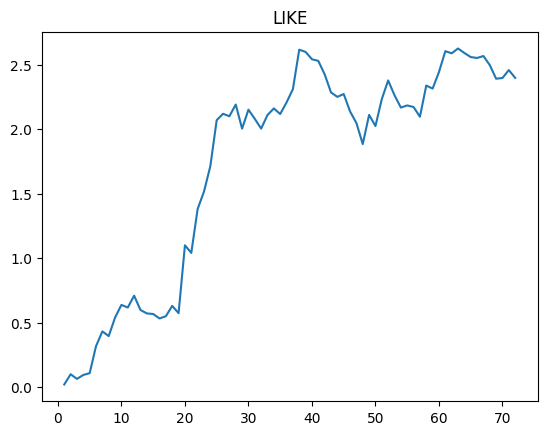

HMND


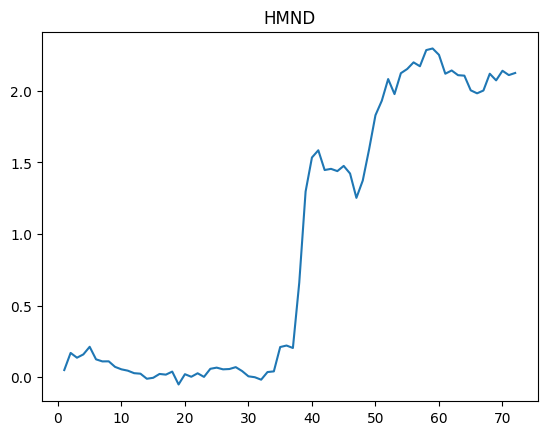

TSUGT


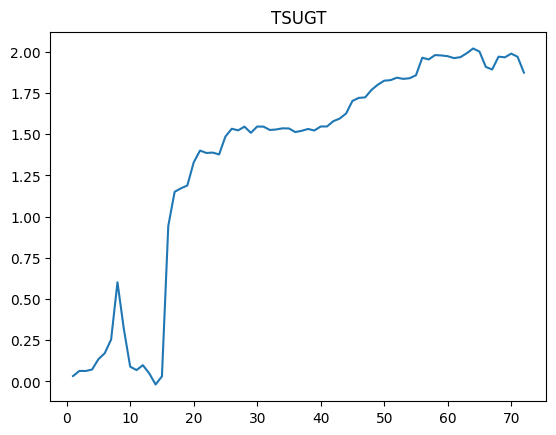

AIOZ


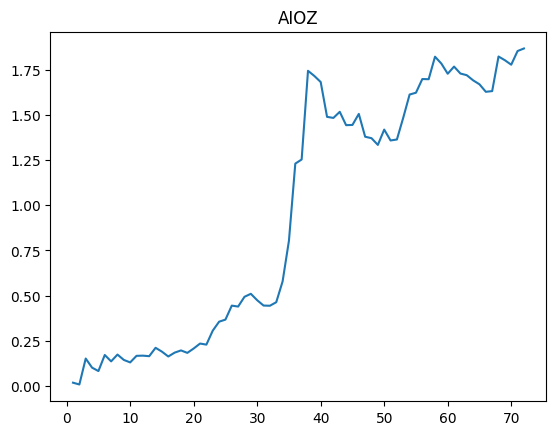

SIDUS


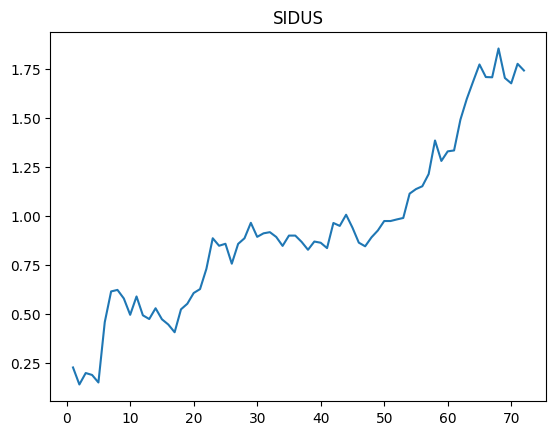

EOSC


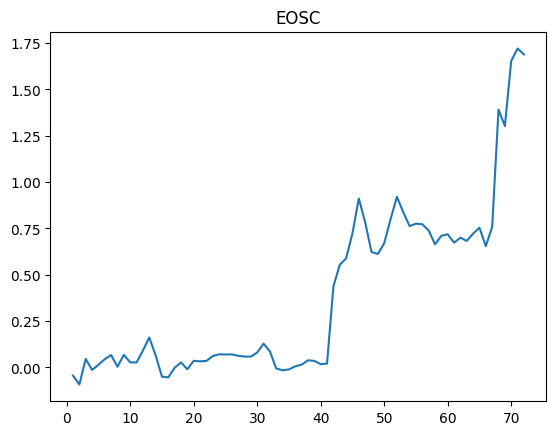

USTC


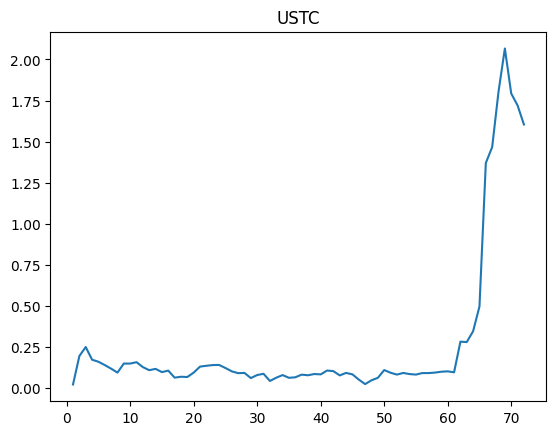

OTK


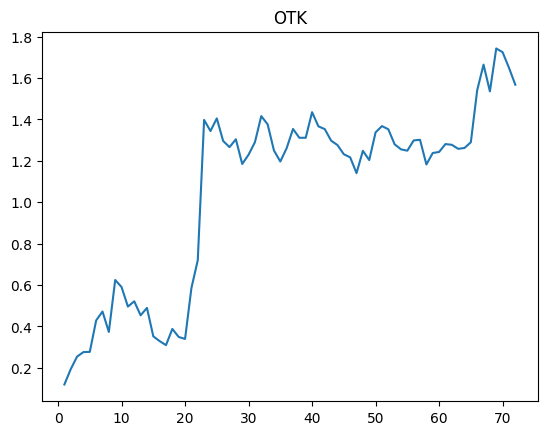

DREAMS


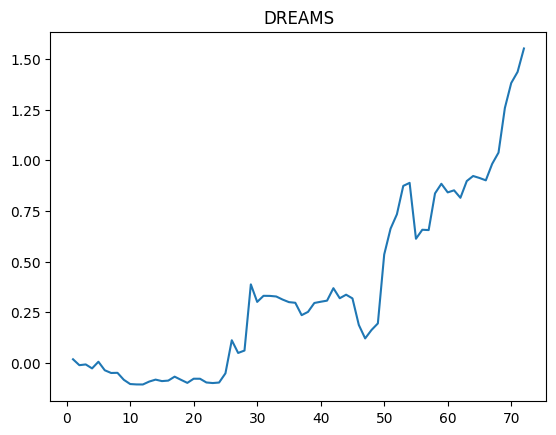

SUPER


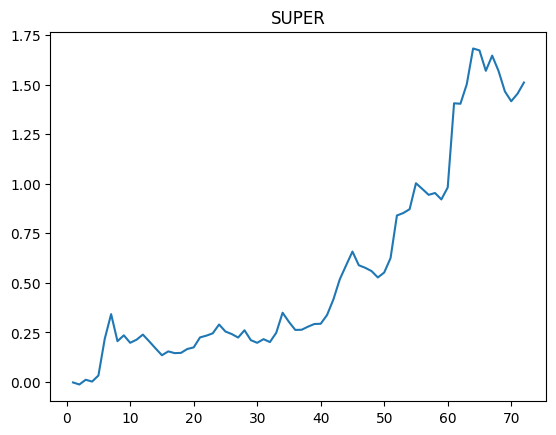

BULL


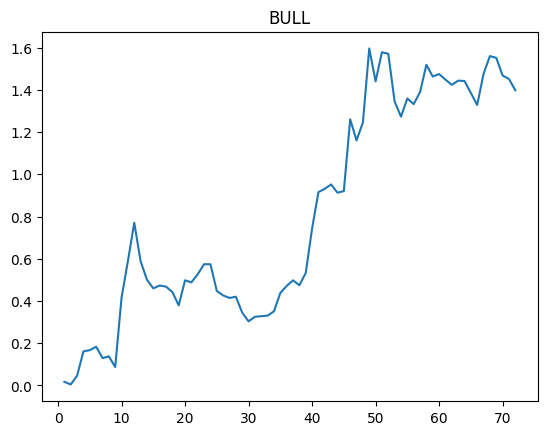

EPIK


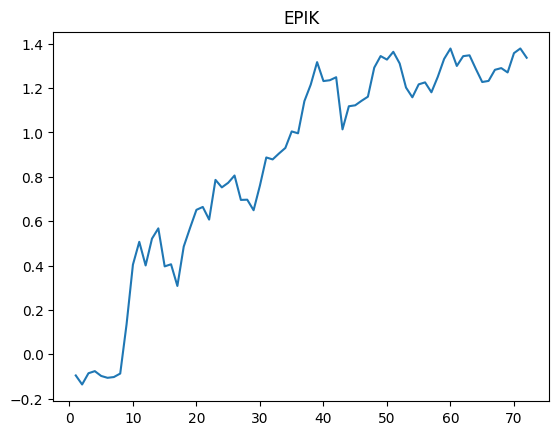

TRADE


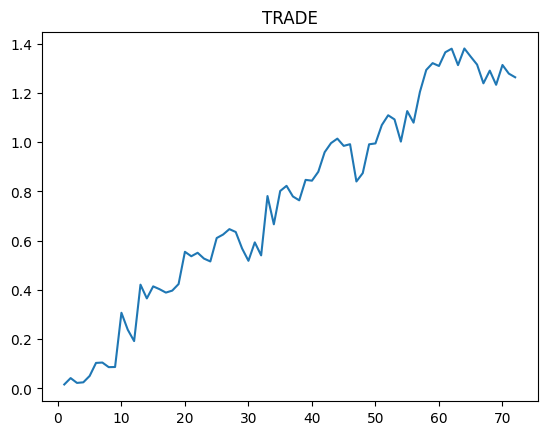

CIRUS


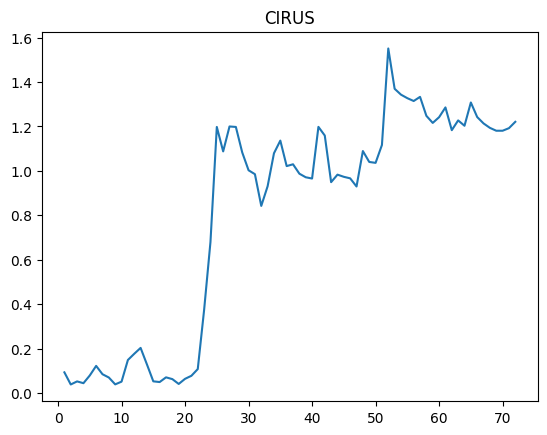

SHRAP


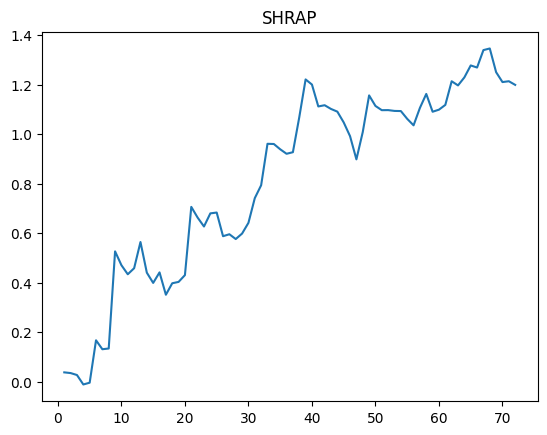

CGPT


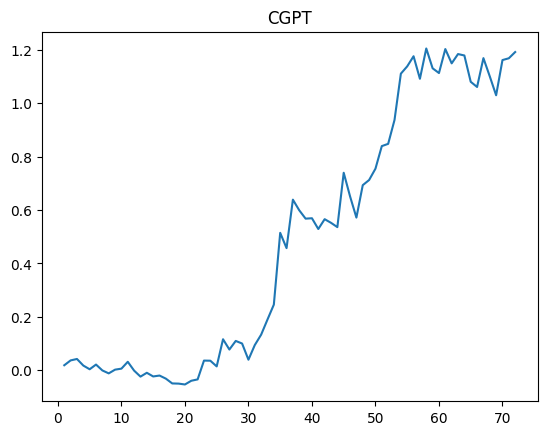

ZELIX


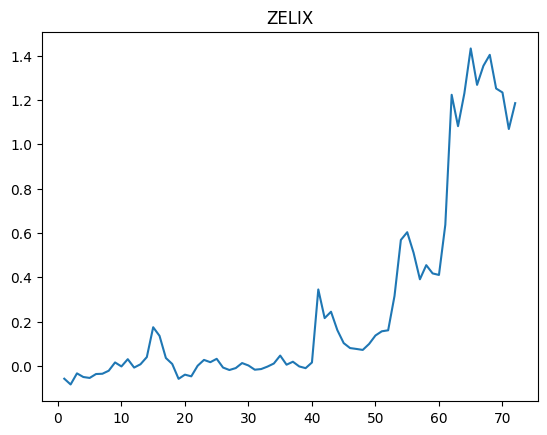

DFYN


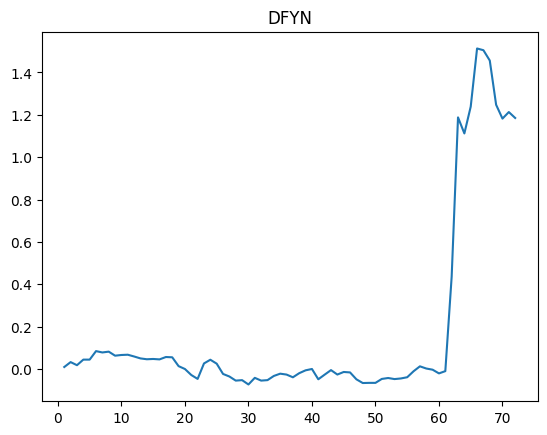

REVU


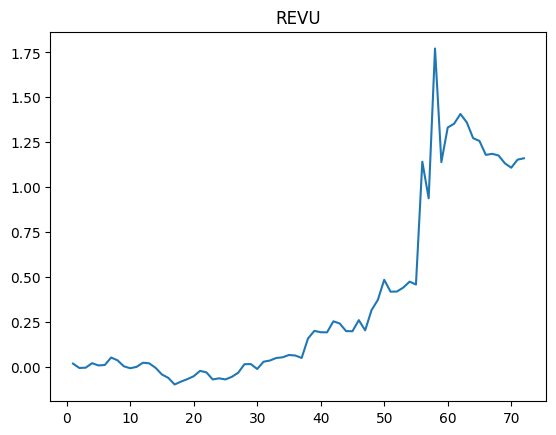

IOI


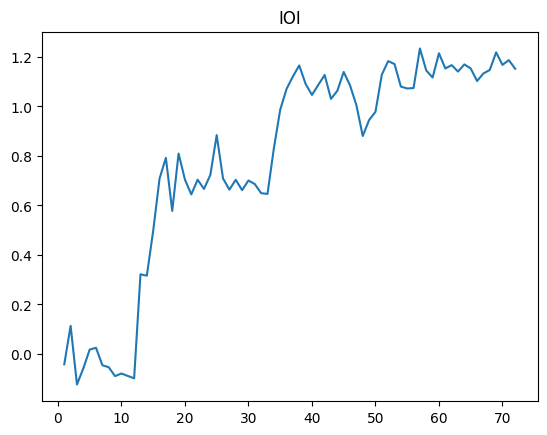

OBI


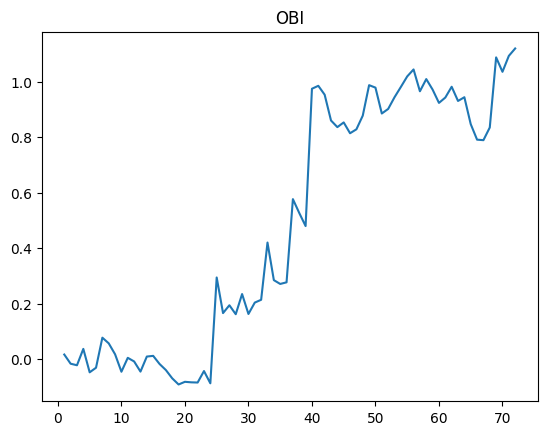

TOKO


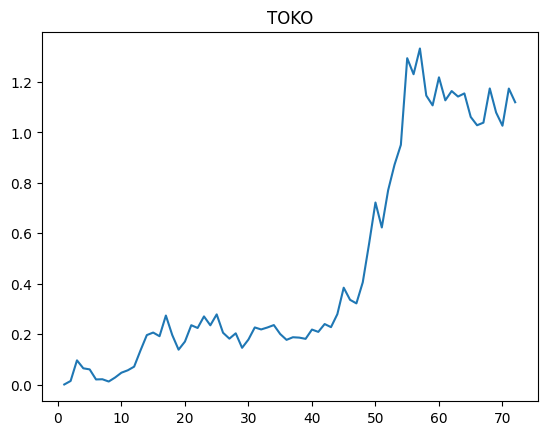

GGG


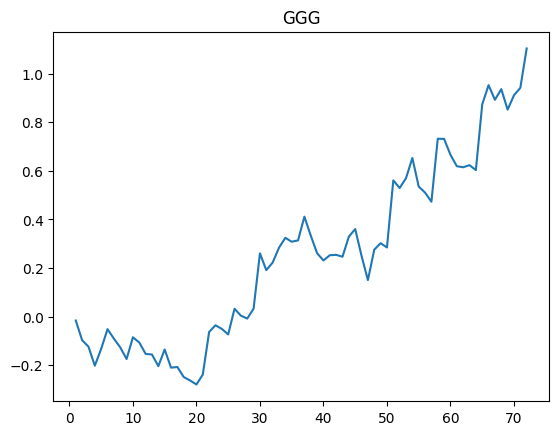

HOTCROSS


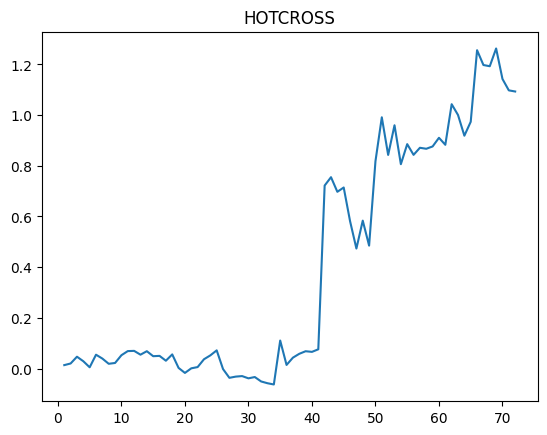

TIA


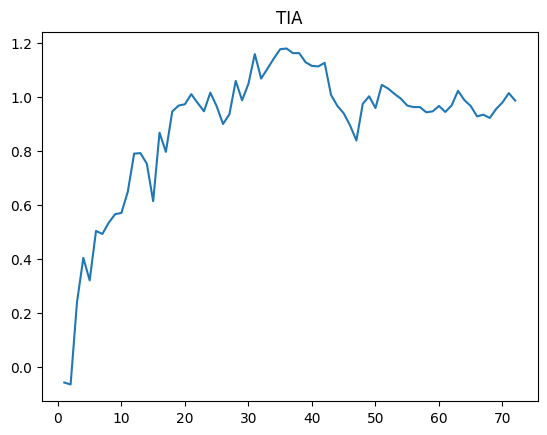

GMEE


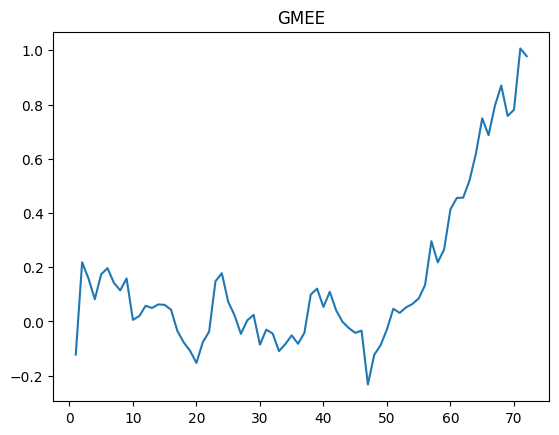

SLIM


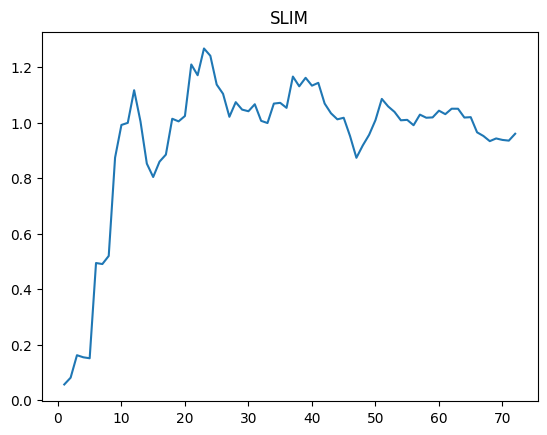

CREDI


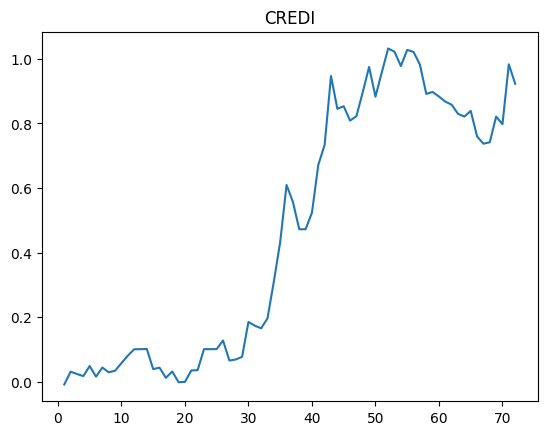

ACQ


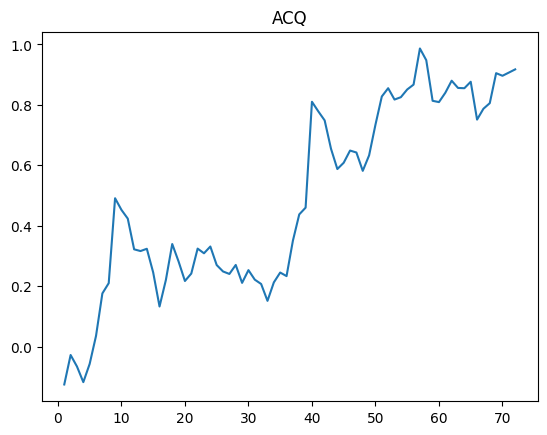

CWAR


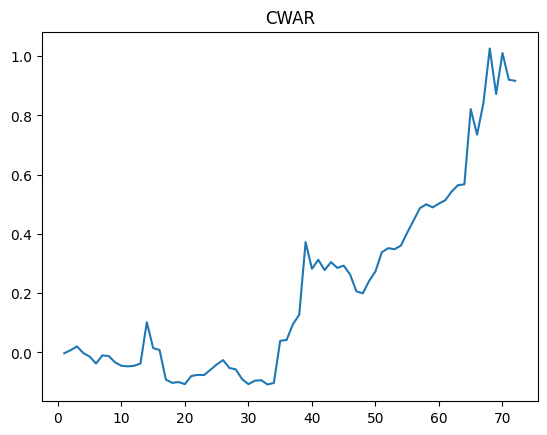

LUNCUP


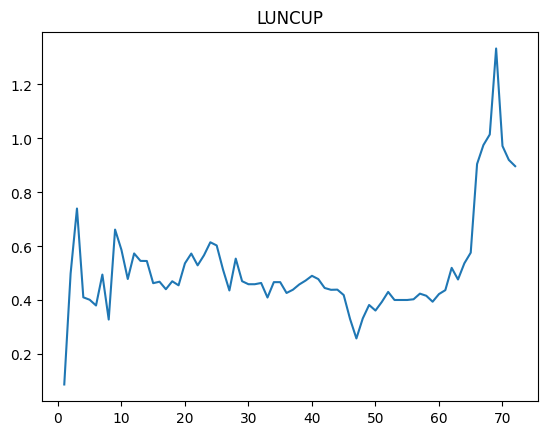

LBP


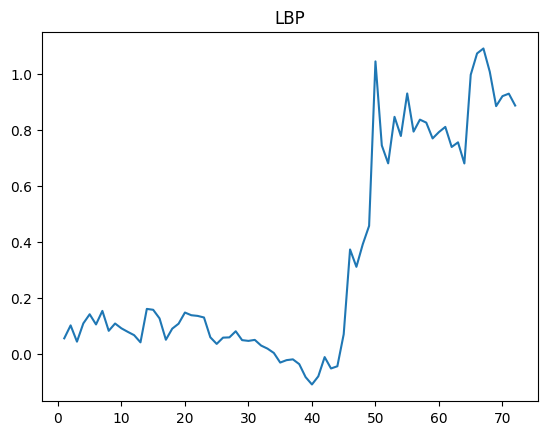

MLS


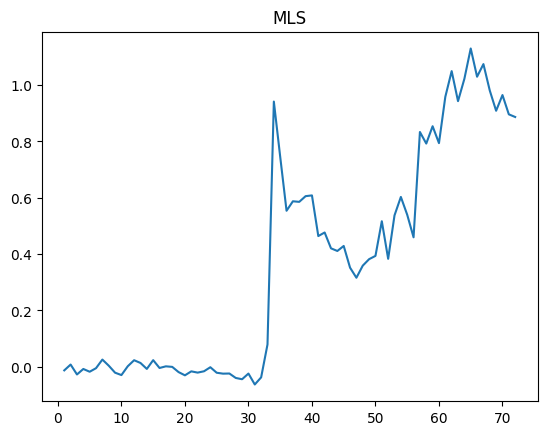

MTS


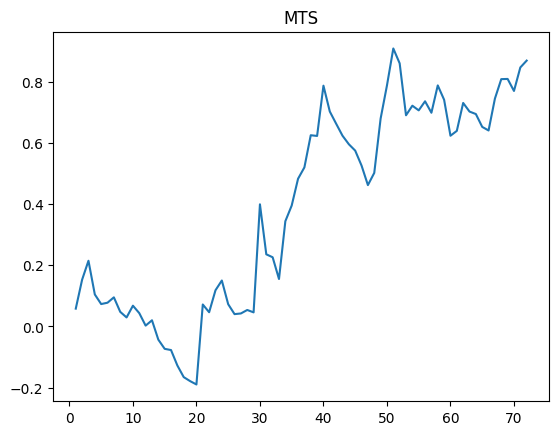

SYLO


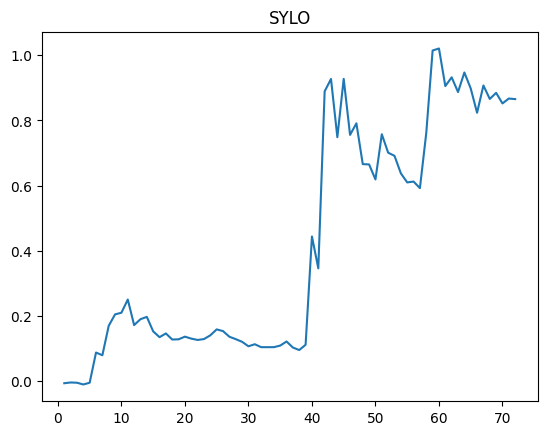

XAVA


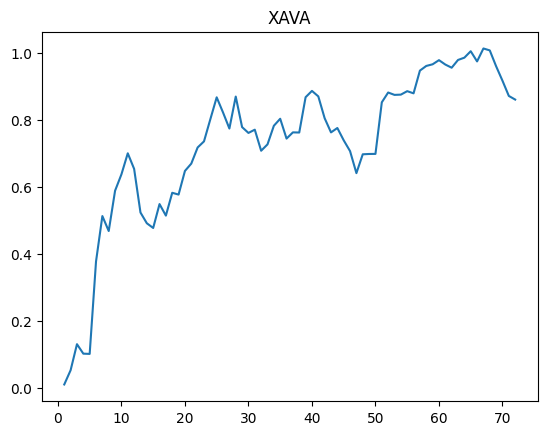

FCON


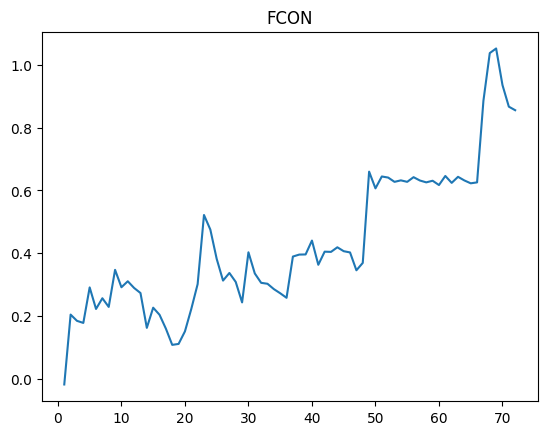

RNDRUP


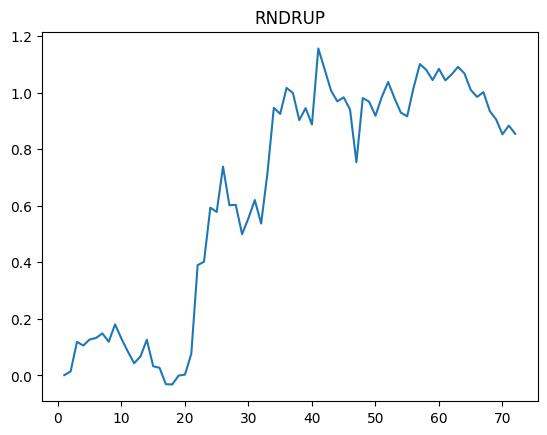

CPOOL


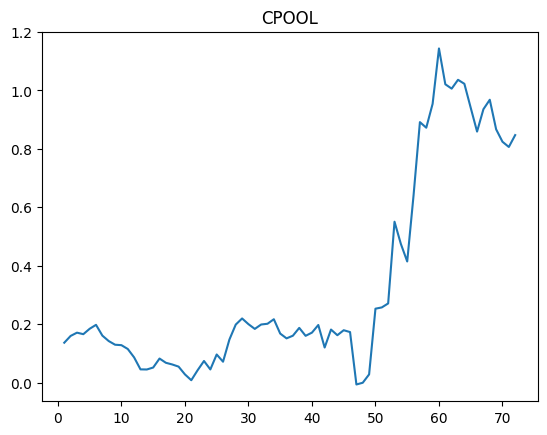

KICKS


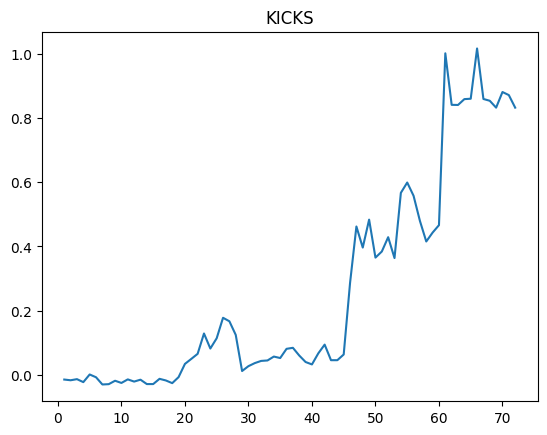

POKT


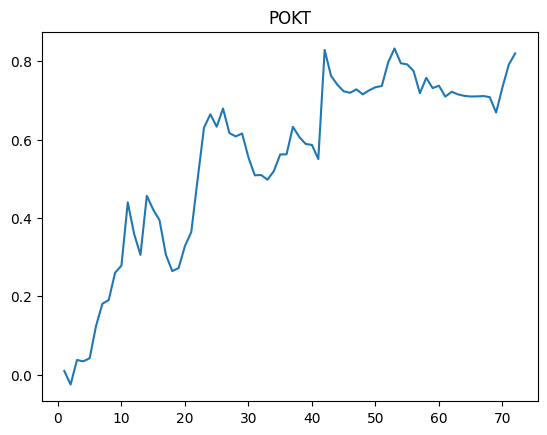

FRR


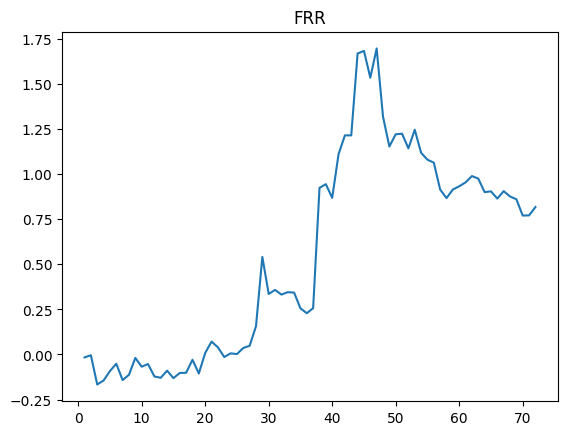

BOLT


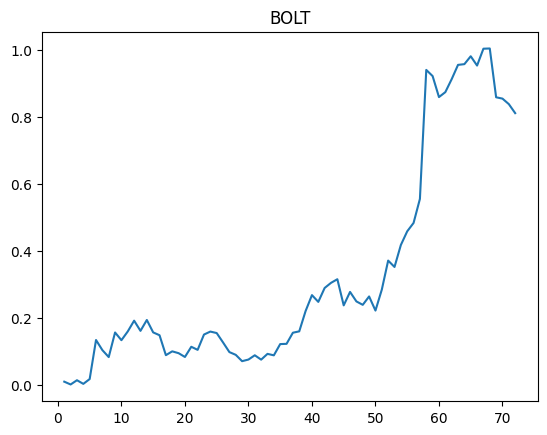

AURY


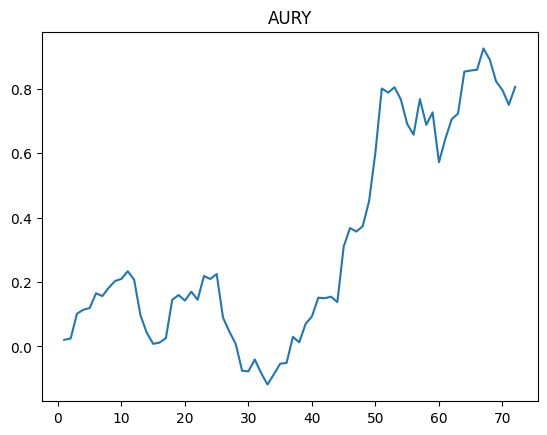

MYRIA


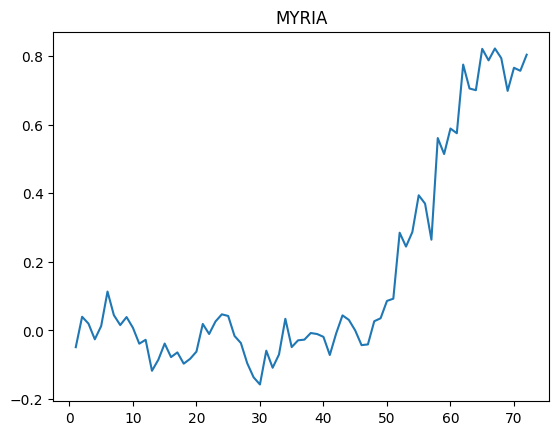

GEM


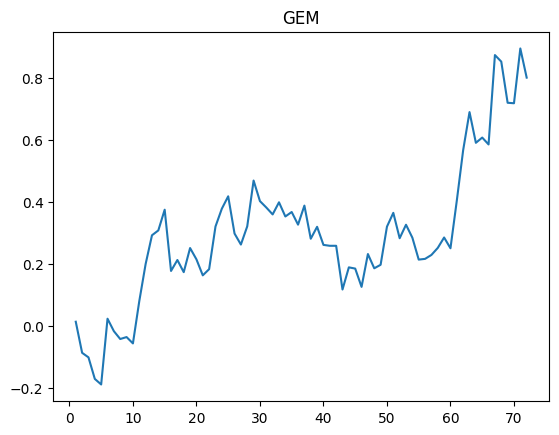

CSIX


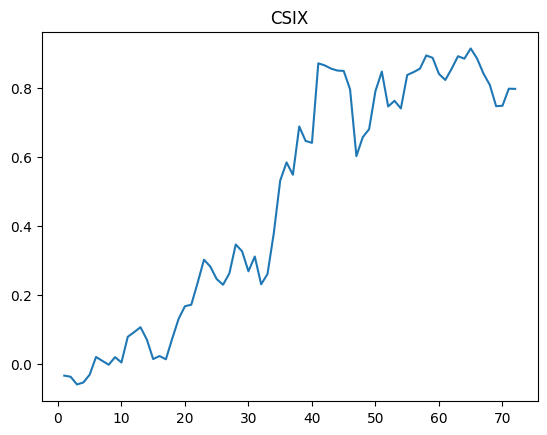

CWS


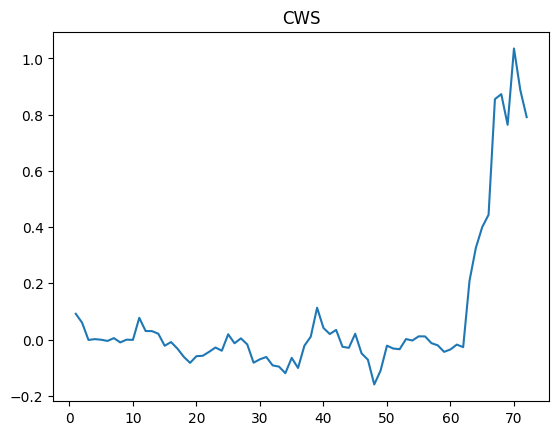

KARATE


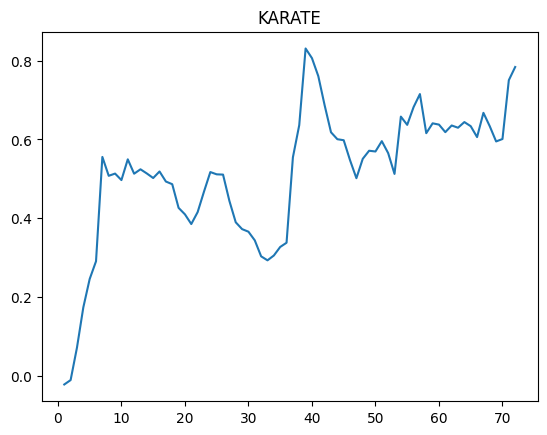

CHMB


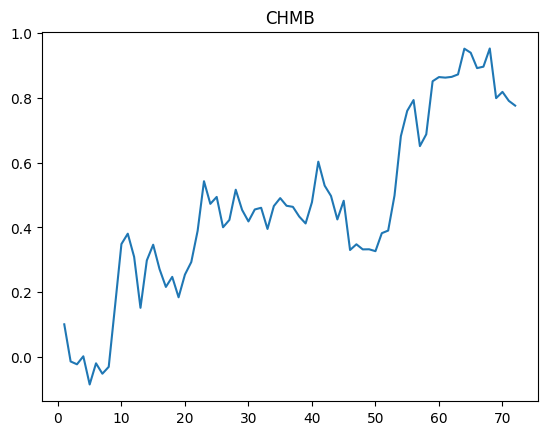

XPLL


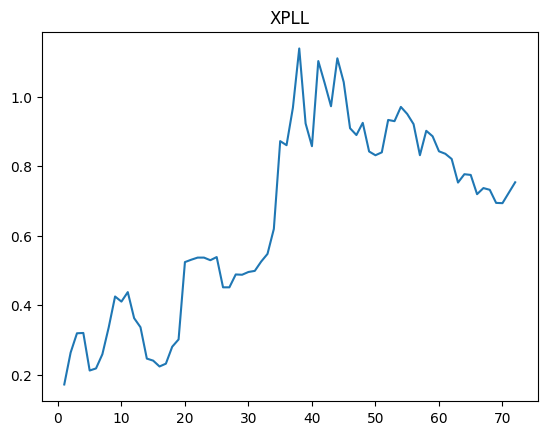

UNFIUP


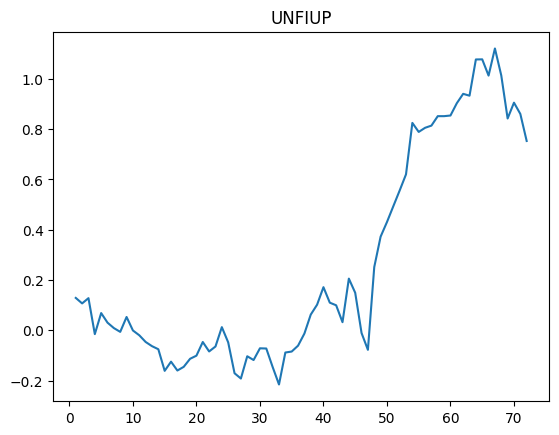

AIEPK


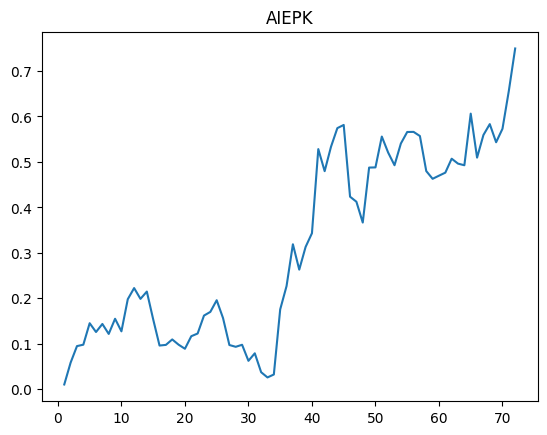

CMP


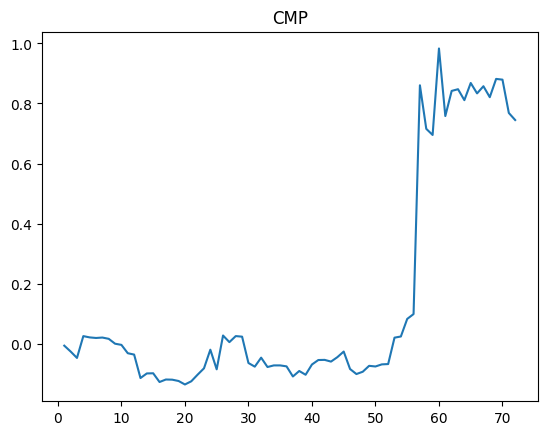

FRM


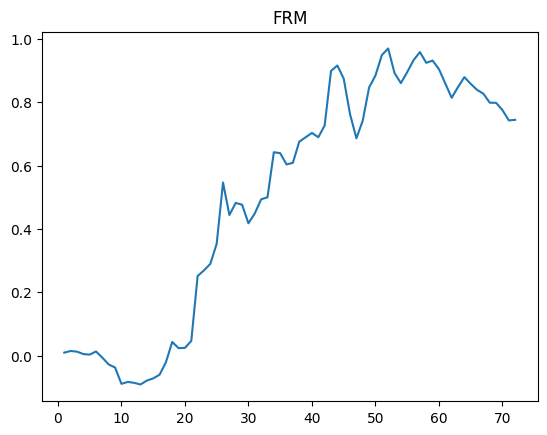

NORD


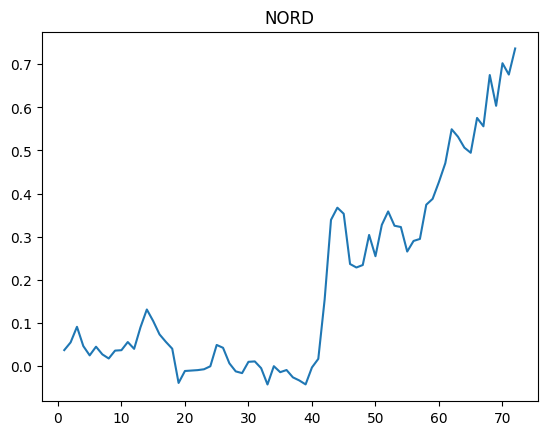

ASTRA


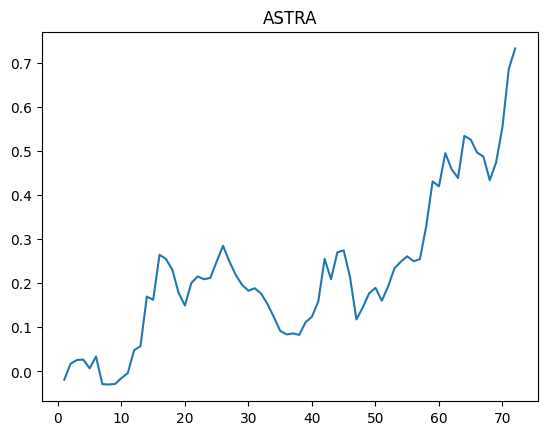

NGL


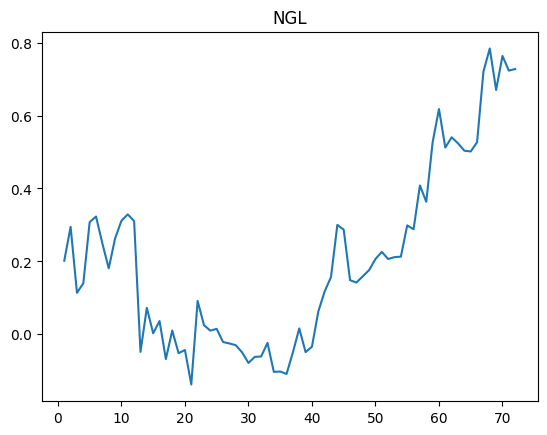

ARKER


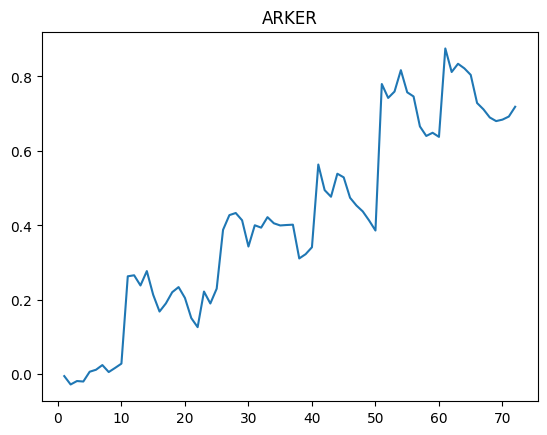

NOM


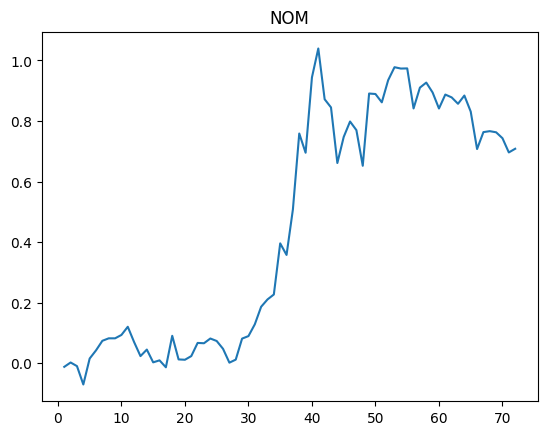

REVV


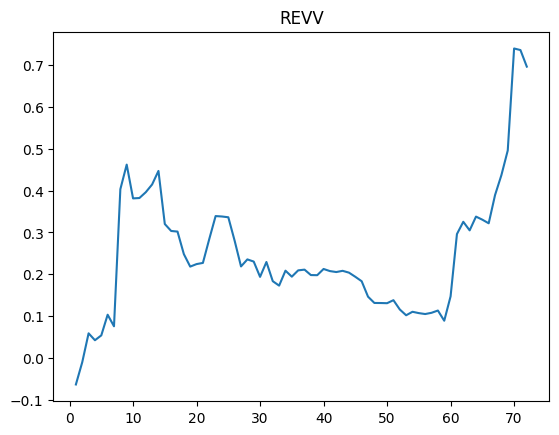

VRTX


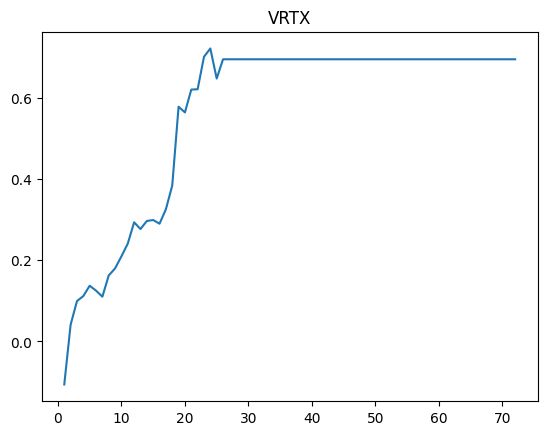

FLIP


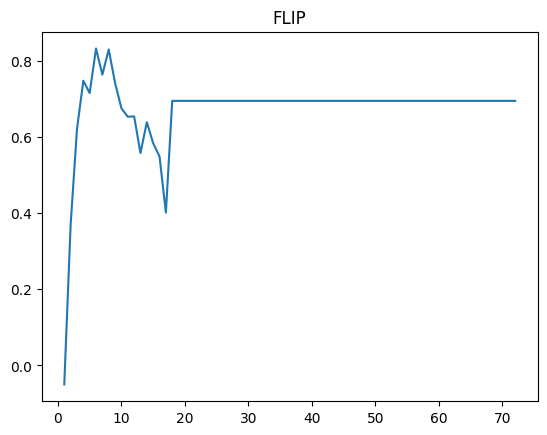

ETHW


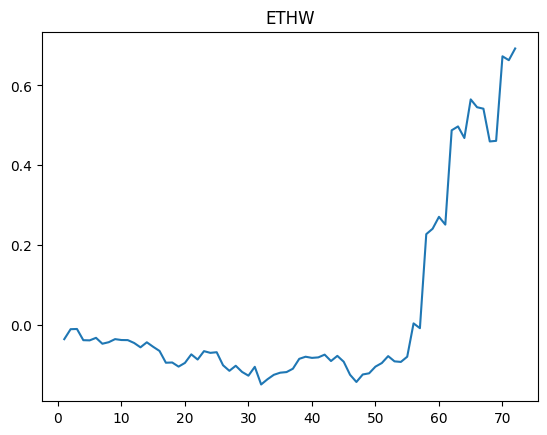

SON


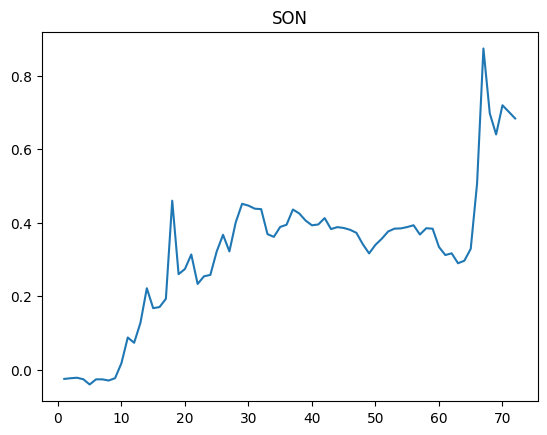

SEI


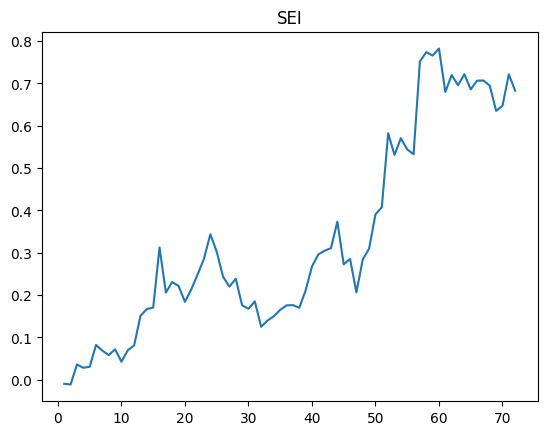

WLDUP


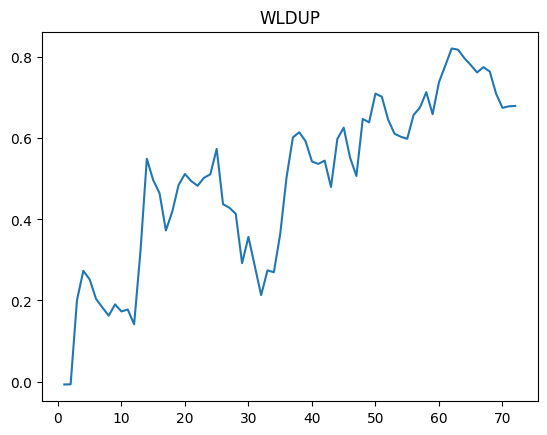

STARLY


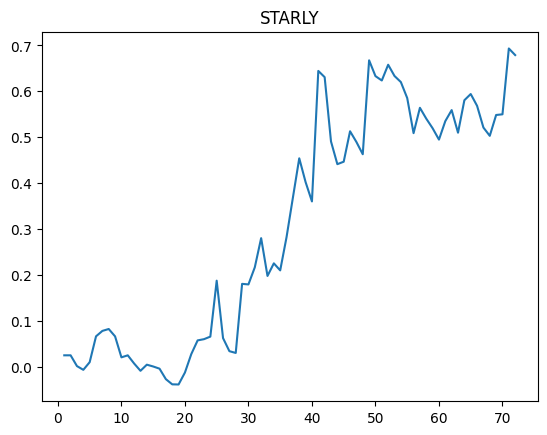

EGAME


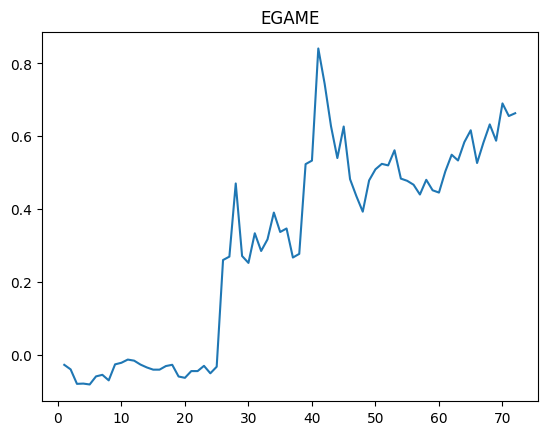

NHCT


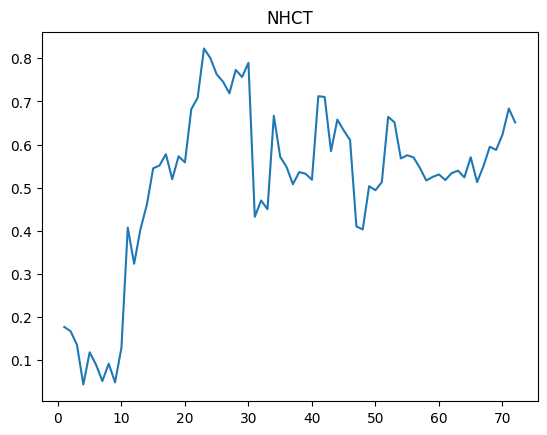

TARA


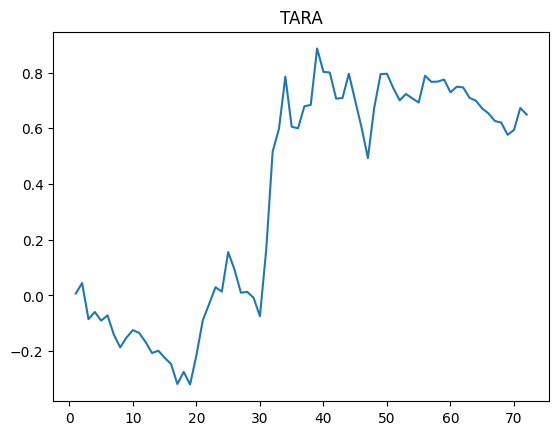

RANKER


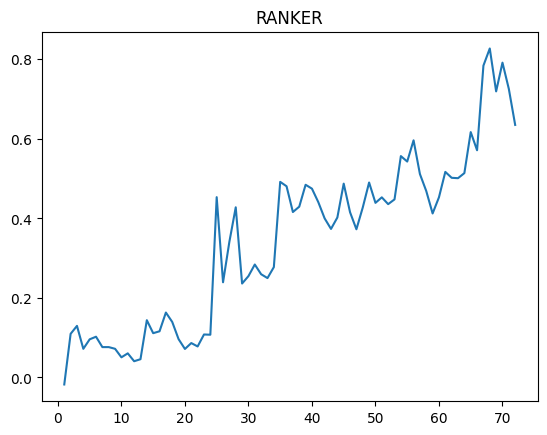

In [48]:
for base in picks_df['index']:
    print(base)
    pct_change_df[base].cumsum().plot(title=base)
    plt.show()

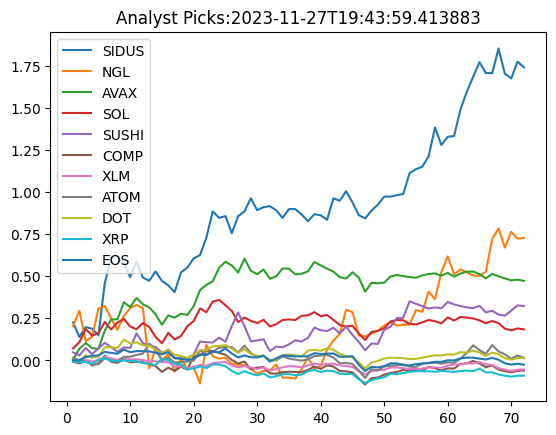

In [49]:
#reviewed_picks=['LUNC','ITAMCUBE','CWEB','ANC','LUNA','BAL','EOS','CAS','POLK','FLUX','ENQ']
#reviewed_picks=['MONI','RVN','RFOX','FRR','ENQ','KNC','APE','GMT']
#reviewed_picks=['MTV','UBX','VERSE','SOL','XLM','ATOM','DOT','XRP','EOS']
reviewed_picks=['SIDUS','NGL','AVAX','SOL','SUSHI','COMP','XLM','ATOM','DOT','XRP','EOS']
# note: 'AVAX','SOL','SUSHI','COMP','XLM','ATOM','DOT','XRP','EOS' are a control set
pct_change_df[reviewed_picks].cumsum().plot()
title="Analyst Picks:" + titleDate
plt.title(title)
file=title+'.png'
#plt.savefig(os.path.join(workingDir,file))

# 4. Control and expand the single exchange results above
- run an asset * exchange pairwise control on the cluster as a chron job
- Show the Exchange asset footprint of the picks

In [50]:
actionable_df=asset_df.loc[reviewed_picks,].T
actionable_df

asset,SIDUS,NGL,AVAX,SOL,SUSHI,COMP,XLM,ATOM,DOT,XRP,EOS
ascendex,1,0,1,1,1,1,1,1,1,1,1
bequant,0,0,1,1,0,1,1,1,1,1,1
bit2c,0,0,0,0,0,0,0,0,0,0,0
bitcoincom,0,0,1,1,1,1,1,1,1,1,1
bitfinex2,1,0,1,1,1,1,1,1,1,1,1
bitget,0,0,1,1,1,1,0,1,1,1,1
bitmart,1,0,1,1,1,1,1,1,1,1,1
bitopro,0,0,0,1,0,0,0,0,0,1,1
bitpanda,0,0,1,1,1,1,1,1,1,1,1
bitrue,1,1,1,1,1,1,1,1,1,1,1


In [51]:
asset_df.index

Index(['BTC', 'ETH', 'LTC', 'XRP', 'BCH', 'USDC', 'USDT', 'DOGE', 'ADA',
       'LINK',
       ...
       'BNCDOT', 'POLYPLAY', 'HIGH3S', 'CVH', 'BNB_ETH', 'BNB_BSC', 'HIT',
       'HIRE', 'POOLXV1', '$CINU'],
      dtype='object', name='asset', length=4923)

In [52]:
# function to get close of a asset on any actionable exchange 
def get_dex_pair(dexpair):
    dex=dexpair[0]
    if dex in actionable_df.index:
        pair=dexpair[1]
        coin=pair.split("/")[0]
        try:
            df=pd.DataFrame.from_dict(exchange_dict[dex].fetch_ticker(pair),orient='index')
            df.columns=[dex]
            df=df[df.index.isin(['symbol','timestamp','close'])]
            return df
        except:
            return None
    else:
        return None
# check
#df=get_dex_pair(('huobi','XLM/USDT'))
#df

# get a list of price checks
- output the number of checks=jobs

In [65]:
checks=[]
for ex in actionable_df.index:
    for coin in reviewed_picks:
        q=coin + "/USDT"
        pair=[ex,q]
        if ex!='sum':
            checks.append(pair)
len(checks)

561

# Set up the SBC jobs to collect the exchange variability for selected assets using ccxt

In [107]:
# limit cluster job submission to a chunk size  
chunk_size=48
start=0
end=chunk_size-1
n=len(checks)
if end > n-1:
        end=n-1
df_list=[]
while start < n:
    print(start,end)
    #futures chunk
    IXN=notebook_client.map(get_dex_pair,checks[start:end])
    # gather results
    check_df_list=notebook_client.gather(IXN)
    check_df_list=[i for i in check_df_list if i is not None]
    #rechunk
    start=start+chunk_size
    end=start+chunk_size-1
    if end > n-1:
        end=n-1
    #accumulate
    df_list=df_list + check_df_list
#    release the memory for chunked and completed futures
    [x.cancel() for x in IXN]
df_list=[x.T for x in df_list]

0 47
48 95
96 143
144 191
192 239
240 287
288 335
336 383
384 431
432 479
480 527
528 560


# Post process and reshape the dataframe list

In [119]:
df_list[0:2]

[              symbol timestamp     close
 ascendex  SIDUS/USDT      None  0.007909,
              symbol timestamp  close
 ascendex  AVAX/USDT      None  20.42]

In [185]:
dex_df=pd.concat(df_list,axis=0)
dex_df[['symbol','close']].head(10)

,symbol,close
ascendex,SIDUS/USDT,0.007909
ascendex,AVAX/USDT,20.42
ascendex,SOL/USDT,55.8634
ascendex,SUSHI/USDT,1.265
ascendex,COMP/USDT,51.4
ascendex,XLM/USDT,0.11763
ascendex,ATOM/USDT,9.0564
ascendex,DOT/USDT,5.2269
ascendex,XRP/USDT,0.6086
ascendex,EOS/USDT,0.673


In [186]:
dex_df.reset_index(inplace=True)
dex_df[['index','symbol','close']].head()

,index,symbol,close
0,ascendex,SIDUS/USDT,0.007909
1,ascendex,AVAX/USDT,20.42
2,ascendex,SOL/USDT,55.8634
3,ascendex,SUSHI/USDT,1.265
4,ascendex,COMP/USDT,51.4


# Exchange x close report

In [187]:
dexNclose_df=dex_df.pivot(index='symbol',columns='index',values='close').T
dexNclose_df

symbol,ATOM/USDT,AVAX/USDT,COMP/USDT,DOT/USDT,EOS/USDT,NGL/USDT,SIDUS/USDT,SOL/USDT,SUSHI/USDT,XLM/USDT,XRP/USDT
index,,,,,,,,,,,
ascendex,9.0564,20.42,51.4,5.2269,0.673,NaN,0.007909,55.8634,1.265,0.11763,0.6086
bequant,9.10349,20.3023,51.297,5.21782,0.67385,NaN,NaN,56.1071,NaN,0.117603,0.607907
bitcoincom,9.10349,20.3023,51.297,5.21782,0.67385,NaN,NaN,56.1193,1.262295,0.117603,0.607907
bitfinex2,9.1283,20.308,51.257,5.218,0.6731,NaN,NaN,NaN,1.2594,0.11748,0.60792
bitget,9.1011,20.3326,51.32,5.223,0.67447,NaN,NaN,NaN,NaN,NaN,0.60847
bitmart,9.0872,NaN,51.241,5.2129,0.673002,NaN,0.008202,56.0401,1.26,NaN,NaN
bitopro,NaN,NaN,NaN,NaN,0.582,NaN,NaN,57.97,NaN,NaN,NaN
bitrue,9.129,20.33,51.4,5.2235,0.673,NaN,0.01397,56.184,1.262,0.1178,0.6087
bitstamp,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.60765


In [145]:
#dexNclose_df.plot()

## Investigate the exchange variability
- scan down columns for each asset
- bittrex,bitrue, cex, lykke seem to be outliers ... interesting
- manually review and filter 
- QC then use API 

# Summarize the Raw dataframe

In [190]:
df_dict={}
for asset in dexNclose_df.columns:
    b=dexNclose_df[asset].max()
    a=dexNclose_df[asset].min()
    std=dexNclose_df[asset].std()
    mean=dexNclose_reviewed[asset].mean()
    c=b/a
#    d=(b-a)/a
#    print(asset,a,b,c)
#    deltaSigma=(b-a)/std
    df_dict[asset]=(mean,a,b,std,c)
Acquisition_df=pd.DataFrame.from_dict(df_dict,orient='index')
Acquisition_df.columns=['mean','min','max','std','FC']
Acquisition_df.sort_values(by='FC',ascending=False,inplace=True)
Acquisition_df

,mean,min,max,std,FC
SIDUS/USDT,0.008142,0.007909,0.013970,0.002206,1.766364
AVAX/USDT,20.305265,11.836000,20.630000,1.772106,1.742987
XLM/USDT,0.117629,0.113575,0.176760,0.012399,1.556327
NGL/USDT,0.205725,0.173830,0.221930,0.024708,1.276707
SUSHI/USDT,1.258599,1.049000,1.307000,0.056131,1.245949
DOT/USDT,5.250810,5.015000,5.870000,0.138867,1.170489
EOS/USDT,0.670500,0.582000,0.679968,0.018589,1.168330
COMP/USDT,51.300118,46.273130,52.400000,1.172826,1.132407
XRP/USDT,0.608029,0.566246,0.608900,0.008327,1.075327
SOL/USDT,56.140877,54.991000,59.000000,0.745143,1.072903


## Summarize after Review 
- without outlier exchanges
- can price x exchange variability be attributed to a few exchanges?
- review exchanges for artifacts in price 

In [171]:
iso_list=['bittrex','cex','lykke','bitrue']
dexNclose_reviewed=dexNclose_df.loc[sorted(list(set(dexNclose_df.index)-set(iso_list))),]
dexNclose_reviewed

symbol,ATOM/USDT,AVAX/USDT,COMP/USDT,DOT/USDT,EOS/USDT,NGL/USDT,SIDUS/USDT,SOL/USDT,SUSHI/USDT,XLM/USDT,XRP/USDT
index,,,,,,,,,,,
ascendex,9.0564,20.42,51.4,5.2269,0.673,NaN,0.007909,55.8634,1.265,0.11763,0.6086
bequant,9.10349,20.3023,51.297,5.21782,0.67385,NaN,NaN,56.1071,NaN,0.117603,0.607907
bitcoincom,9.10349,20.3023,51.297,5.21782,0.67385,NaN,NaN,56.1193,1.262295,0.117603,0.607907
bitfinex2,9.1283,20.308,51.257,5.218,0.6731,NaN,NaN,NaN,1.2594,0.11748,0.60792
bitget,9.1011,20.3326,51.32,5.223,0.67447,NaN,NaN,NaN,NaN,NaN,0.60847
bitmart,9.0872,NaN,51.241,5.2129,0.673002,NaN,0.008202,56.0401,1.26,NaN,NaN
bitopro,NaN,NaN,NaN,NaN,0.582,NaN,NaN,57.97,NaN,NaN,NaN
bitstamp,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.60765
coinbaseprime,9.1,20.34,NaN,5.23,NaN,NaN,NaN,56.15,NaN,0.1176,0.6089


# A New Summary
- do the excluded exchanges account for the variability in price above 5%?

In [189]:
df_dict={}
for asset in dexNclose_reviewed.columns:
    b=dexNclose_reviewed[asset].max()
    a=dexNclose_reviewed[asset].min()
    std=dexNclose_reviewed[asset].std()
    mean=dexNclose_reviewed[asset].mean()
    c=b/a
#    d=(b-a)/a
#    print(asset,a,b,c)
#    deltaSigma=(b-a)/std
    df_dict[asset]=(mean,a,b,std,c)
Acquisition_reviewed_df=pd.DataFrame.from_dict(df_dict,orient='index')
Acquisition_reviewed_df.columns=['mean','min','max','std','FC']
Acquisition_reviewed_df.sort_values(by='FC',ascending=False,inplace=True)
Acquisition_reviewed_df

,mean,min,max,std,FC
NGL/USDT,0.205725,0.173830,0.221930,0.024708,1.276707
EOS/USDT,0.670500,0.582000,0.679968,0.019824,1.168330
DOT/USDT,5.250810,5.193200,5.870000,0.138794,1.130324
SUSHI/USDT,1.258599,1.186700,1.307000,0.021987,1.101374
SOL/USDT,56.140877,54.991000,57.970000,0.485258,1.054173
SIDUS/USDT,0.008142,0.007909,0.008210,0.000118,1.038071
AVAX/USDT,20.305265,20.080000,20.420000,0.079449,1.016932
ATOM/USDT,9.096367,9.004000,9.140126,0.032539,1.015118
COMP/USDT,51.300118,50.900000,51.490000,0.161177,1.011591
XLM/USDT,0.117629,0.116980,0.117955,0.000279,1.008335


## Reject Hypothesis! still getting over 5% deltas on selected assets
- auto acquisition picker...
- there is scope for an alarm app ...

# key modules
- python
- prophet
- dask
- pandas
- ccxt
- jupyterlab/jupyter notebooks
- plotly

# Demo Complete
- Copyright 11/27/2023 Daniel J. McGoldrick 